# <center>Climate Change Analysis</center>
## Overview
This project is to analyze the climate change over the recent years and to estimate the effect it will have on life of Earth in the coming decades. While many factors influence climate change, a majority of the problem according to many journals from climate experts is caused by humans.<br>
This project takes some of the factors that cause climate change and are linked to human activity - Deforestation, fossil fuel burning, and raise in atmospheric CO2 levels. The aim of this project is to establish a correlation between human factors, temperature rise, and raise in the rate of occurance of natural events like thunderstorms, hails, tornados, rain, and snow.
<br><br>
<center>Human factors &rarr; Temperature change &rarr; Raise in natural calamities</center>
<br>

The report provides analysis for US regions based on similar climate conditions in various states as provided by National Oceanic and Atmospheric Administration (NOAA) of USA.

The states are clustered into various regions as shown in this picture from NOAA:

![US Regions](https://www.ncdc.noaa.gov/monitoring-references/maps/images/us-climate-regions.gif)

*Alaska and Hawaii are not part of any regions within US contiguous states.

*Some charts in the report are interactive. Select the legend to see certain elements of the chart. Select the area of the chart to zoom in. Double click to reset. Interactive charts are indicated by symbol* &#9757;

In [481]:
from IPython.display import HTML

In [482]:
HTML('''<script>
function code_toggle() {
 if (code_show){
 $('div.input').hide('500');
 $('div.prompt').hide();
 } else {
 $('div.input').show('500');
 $('div.prompt').show();
 }
 code_show = !code_show
} 
$( document ).ready(function(){
    code_show=true;
    $('div.input').show()
    $('div.prompt').show();
  });
</script>
<font size="4" color='red'>The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.</font>''')

In [483]:
#Import all the required packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import warnings

import scipy.stats as st

In [484]:
#Set the report styling parameters using Jupyter Notebook magic commands

%matplotlib inline
init_notebook_mode(connected=True)
plt.rcParams['figure.figsize'] = (12, 9)
sns.set()

warnings.filterwarnings('ignore')

In [485]:
#Functions and variables for statistical analysis:

alpha = 0.05
num_iterations=10000

def extract_subdata_yearly(climate_data):
    Climate_Data_Region_1975 = climate_data[(climate_data.index.get_level_values('Date').year>=1975) & (climate_data.index.get_level_values('Date').year<=1979)]
    Climate_Data_Region_2018 = climate_data[(climate_data.index.get_level_values('Date').year>=2014) & (climate_data.index.get_level_values('Date').year<=2018)]
    return Climate_Data_Region_1975, Climate_Data_Region_2018
    
    
def draw_bs_samples(data,func,iterations):
    return [func(np.random.choice(data,replace=True,size=len(data))) for i in range(iterations)]
         

def bootstrap_test_sifted_mean(bs_data1,bs_data2):
    empirical_diff_means = np.mean(bs_data1) - np.mean(bs_data2)
    data_concat = np.concatenate((bs_data1,bs_data2))
    
    shifted_data1 = np.array(bs_data1) - np.mean(bs_data1) + np.mean(data_concat)
    shifted_data2 = np.array(bs_data2) - np.mean(bs_data2) + np.mean(data_concat)

    bs_shifted_data1 = draw_bs_samples(shifted_data1,np.mean,num_iterations)
    bs_shifted_data2 = draw_bs_samples(shifted_data2,np.mean,num_iterations)

    bs_shifted_diff_mean = np.array(bs_shifted_data2) - np.array(bs_shifted_data1)
    
    # only need the difference for this case. so used the min of p-value.
    #z_shifted = (np.mean(bs_shifted_diff_mean)-empirical_diff_means)/np.std(bs_shifted_diff_mean)
    #p_shifted = min(st.norm.cdf(z_shifted),1-st.norm.cdf(z_shifted))
    p_shifted = min(np.sum(bs_shifted_diff_mean >= empirical_diff_means)/len(bs_shifted_diff_mean),np.sum(bs_shifted_diff_mean <= empirical_diff_means)/len(bs_shifted_diff_mean))
    _95_CI_shifted = np.percentile(bs_shifted_diff_mean,[2.5,97.5])
    
    return _95_CI_shifted, p_shifted, bs_shifted_diff_mean, empirical_diff_means


In [486]:
#Load and merge the data from github. These files are cleaned and forecasted in other Python programs. 
#Check my github repository (https://github.com/KrishnaMuluguru/ClimateChangeProject1) for the data wrangling code and details. 

#Github links:
#https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/CO2_Concentration_forecasted.csv
#https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/GSOD_All_Data_no_outliers.csv
#https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/Fuel_Consumption.csv
#https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/Land_Use_Data.csv
#https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/State_Zones.xlsx

#Local links: DHG
#C:\Users\km4147\OneDrive\Documents\Python Scripts\ClimateChangeAnalysis\Clean_Data\CO2_Concentration_forecasted.csv
#C:\Users\km4147\OneDrive\Documents\Python Scripts\ClimateChangeAnalysis\Clean_Data\GSOD_All_Data_no_outliers.csv
#C:\Users\km4147\OneDrive\Documents\Python Scripts\ClimateChangeAnalysis\Clean_Data\Fuel_Consumption.csv
#C:\Users\km4147\OneDrive\Documents\Python Scripts\ClimateChangeAnalysis\Clean_Data\Land_Use_Data.csv

CO2_Concentration = pd.read_csv(r'https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/CO2_Concentration_Completed.csv',parse_dates = ['Date'],index_col=['Date','State'])
Temperature_Data = pd.read_csv(r'https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/GSOD_All_Data_no_outliers.csv',parse_dates = ['Date'],index_col=['Date','State'])
Fuel_Consumption = pd.read_csv(r'https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/Fuel_Consumption.csv',parse_dates = ['Date'],index_col=['Date','State'])
Land_Use = pd.read_csv(r'https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/Land_Use_Data.csv',parse_dates = ['Date'],index_col=['Date','State'])
State_Regions = pd.read_excel(r'https://raw.githubusercontent.com/chaitu038/ClimateChangeProject1/master/Data-Folder/State_Regions.xlsx',usecols=[0,1,2],index_col=[0])

Climate_Data1 = pd.merge(CO2_Concentration, Temperature_Data, how='right', left_index=True, right_index=True)
Climate_Data2 = pd.merge(Fuel_Consumption, Land_Use, how='outer', left_index=True, right_index=True)
Climate_Data3 = pd.merge(Climate_Data1, Climate_Data2, how='left', left_index=True, right_index=True)
Climate_Data = pd.merge(State_Regions,Climate_Data3,how='left',left_index=True,right_index=True)

Climate_Data.head()

StateName     Region  CO2_Concentration    TempAVG  \
Date       State                                                        
1975-01-31 AK         Alaska        NaN             336.62   3.271453   
           AL        Alabama  Southeast             336.62  52.333233   
           AR       Arkansas      South             336.62  44.253495   
           AZ        Arizona  Southwest             336.62  43.045721   
           CA     California       West             336.62  47.822063   

                    TempMAX    TempMIN  Rain  Snow  Hail  Thunder  Tornado  \
Date       State                                                             
1975-01-31 AK     10.173884  -3.819460   323  1033     8        5        0   
           AL     63.070469  43.368865   146     9     0       24        0   
           AR     55.329032  35.013710   141    17     1       32        0   
           AZ     57.322988  30.489250    47    42     0        1        0   
           CA     59.580878  37.971123   392    57     3        8        0   

                  Coal_Consumption  Petrol_Consumption  Forest_Area  \
Date       State                                                      
1975-01-31 AK            65.091667         1769.687500     118073.0   
           AL          2250.875000         7345.320833      21333.0   
           AR             6.770833         5411.437500      18236.0   
           AZ           266.954167         4749.350000      17421.0   
           CA           184.612500        43668.012500      39768.0   

                  Urban_Area  
Date       State              
1975-01-31 AK           87.0  
           AL          722.0  
           AR          423.0  
           AZ          536.0  
           CA         3560.0

## Northwest

In [487]:
Current_Region = 'Northwest'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Northwest region since 1975.

The chart shows fluctuations in the trend in Northwest region temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [488]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

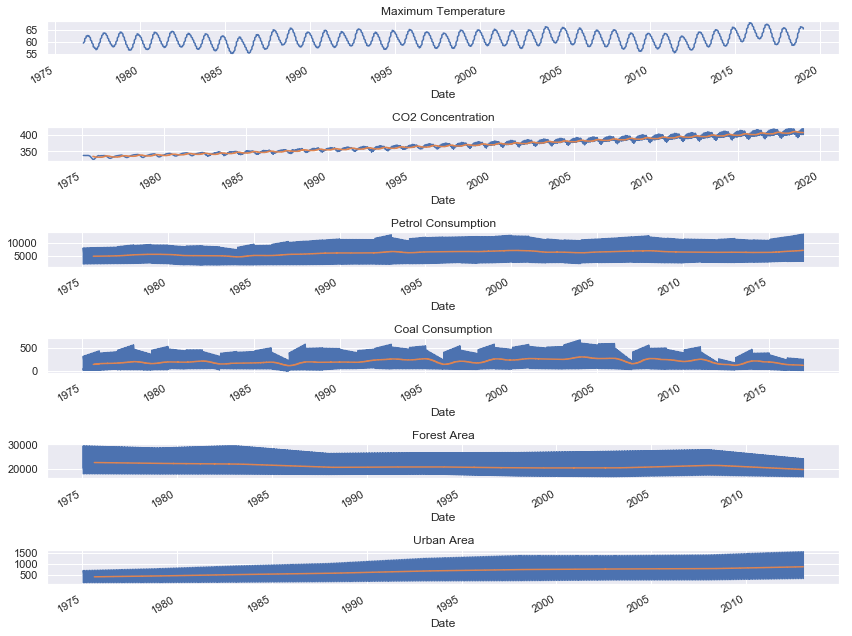

In [489]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have much effect on overall temperatures, with slight increase in min temperature<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

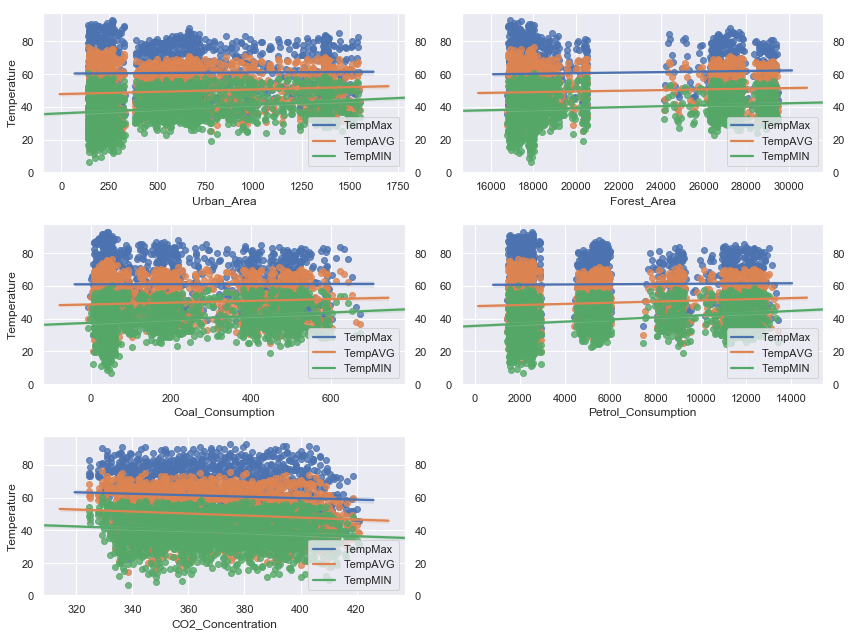

In [490]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

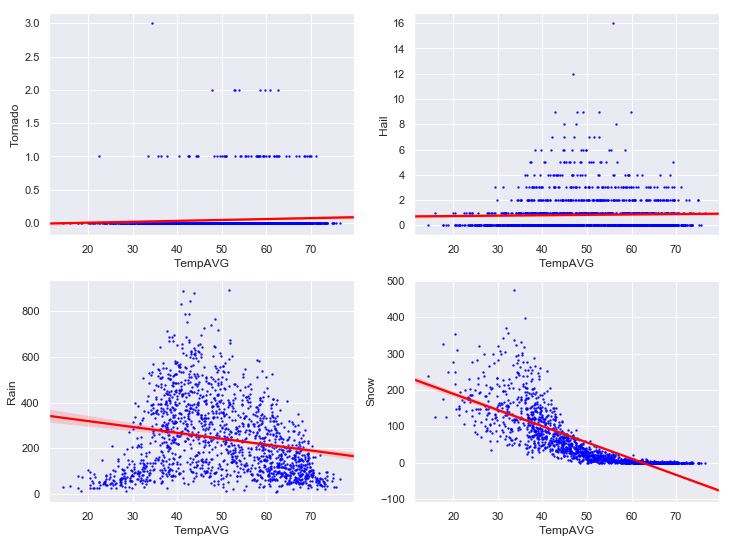

In [491]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

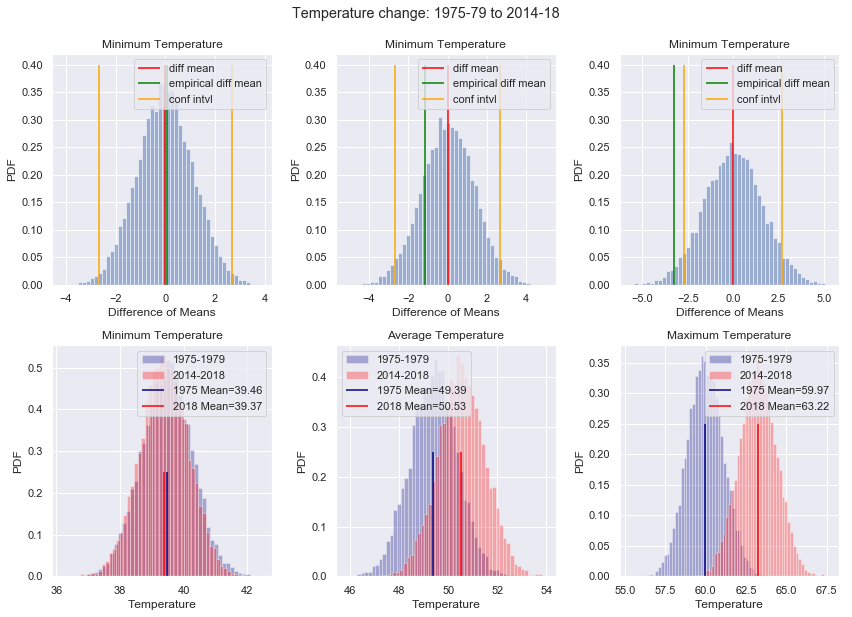

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.4697
Compare Means p-value = 0.4554
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.1934
Compare Means p-value = 0.1173
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.022
Compare Means p-value = 0.0019
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in Northwest between 1975-79 and 2014-18 changed around 4.17F


In [492]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.4,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.4,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.4,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.4,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.4,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.4,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.4,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.4,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.4,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Northwest
The visual data analysis and statistical data analysis of temperatures in Northwest region from 1975 show that the climate change doesn't have any effect on the temperature trend in Northwest.

## West North Central

In [493]:
Current_Region = 'West North Central'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for West North Central region since 1975.

The chart shows fluctuations in the trend in West North Central region temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [494]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

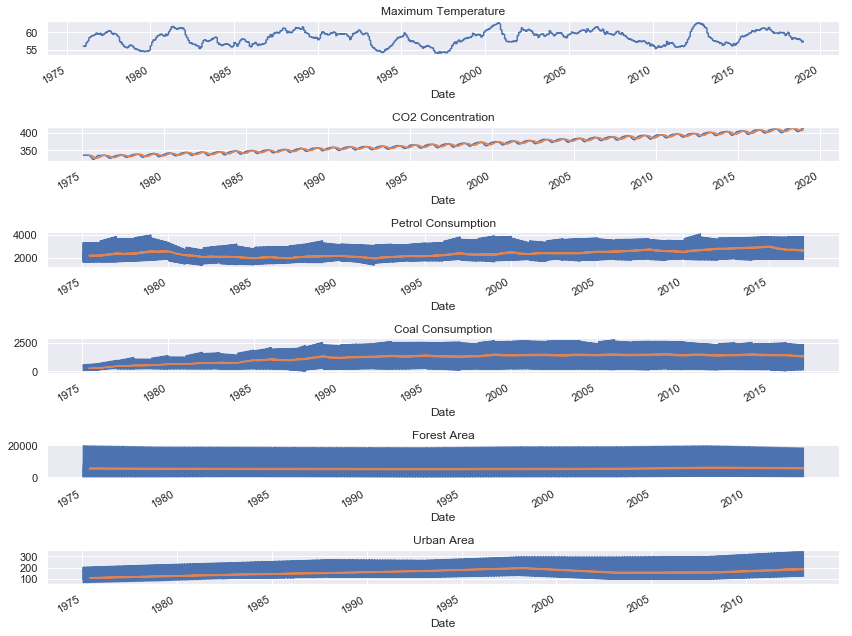

In [495]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area seems to decrease temperatures<br>
**Coal Consumption:** Increase in consumption of coal shows a slight decrease in temperatures - possibly due to weak correlation here<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

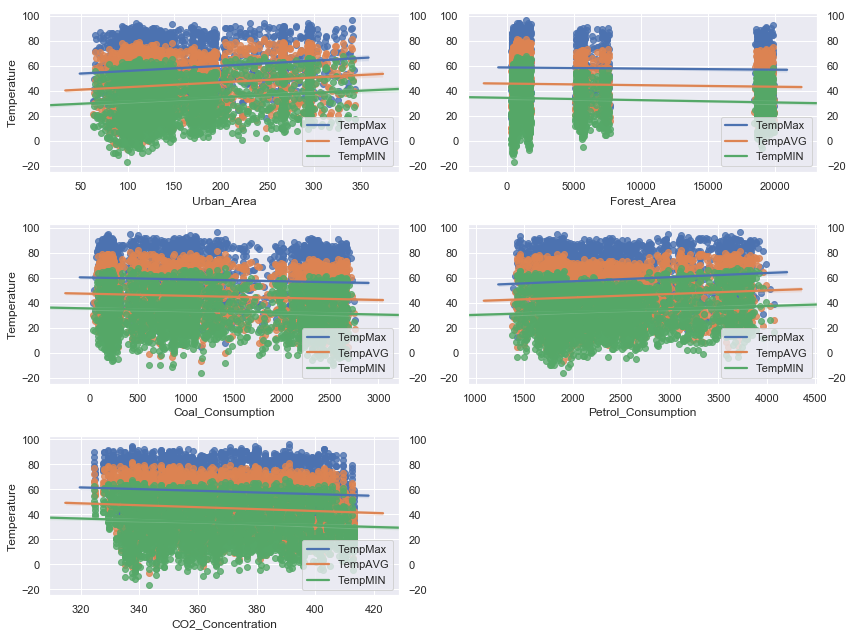

In [496]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

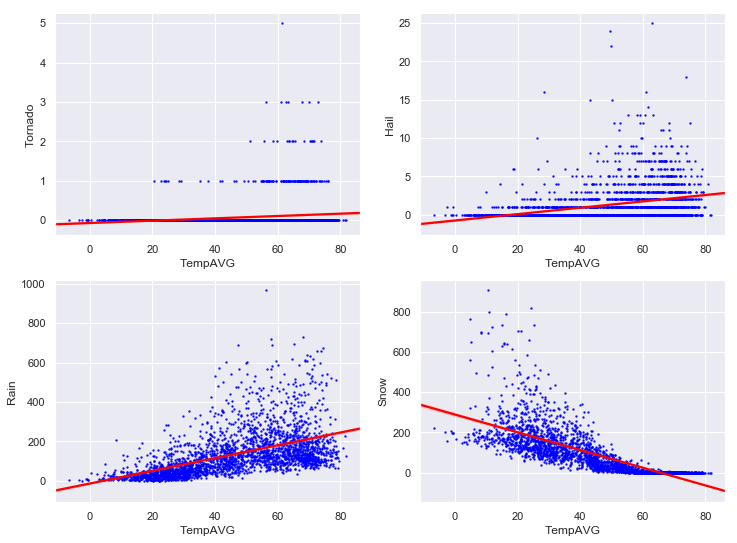

In [497]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

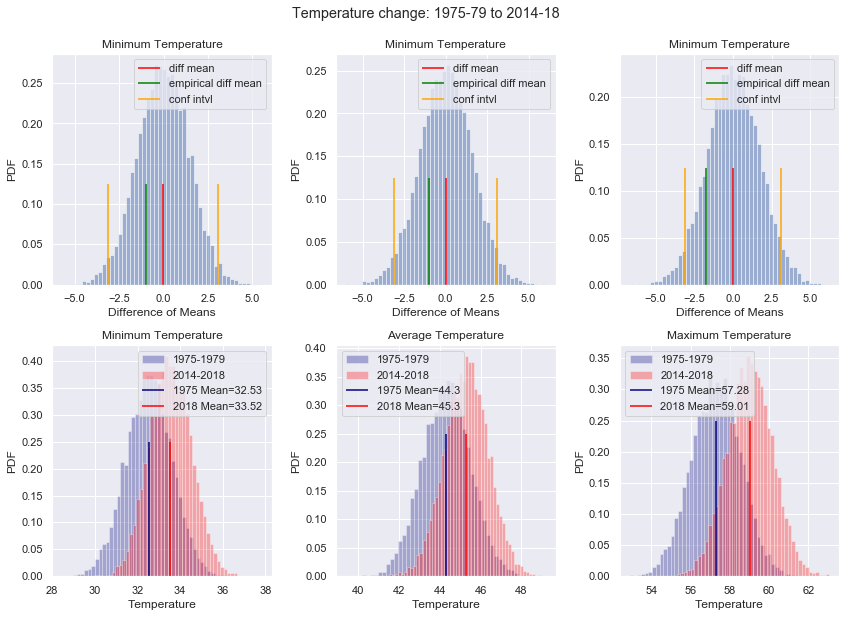

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.2538
Compare Means p-value = 0.1782
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.2646
Compare Means p-value = 0.2
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.1517
Compare Means p-value = 0.0839
    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018


In [498]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for West North Central
The visual data analysis and statistical data analysis of temperatures in West North Central region from 1975 show that the climate change doesn't have any effect on the temperature trend in West North Central region. 

## East North Central

In [499]:
Current_Region = 'East North Central'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for East North Central region since 1975.

The chart shows fluctuations in the trend in East North Central region temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [500]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

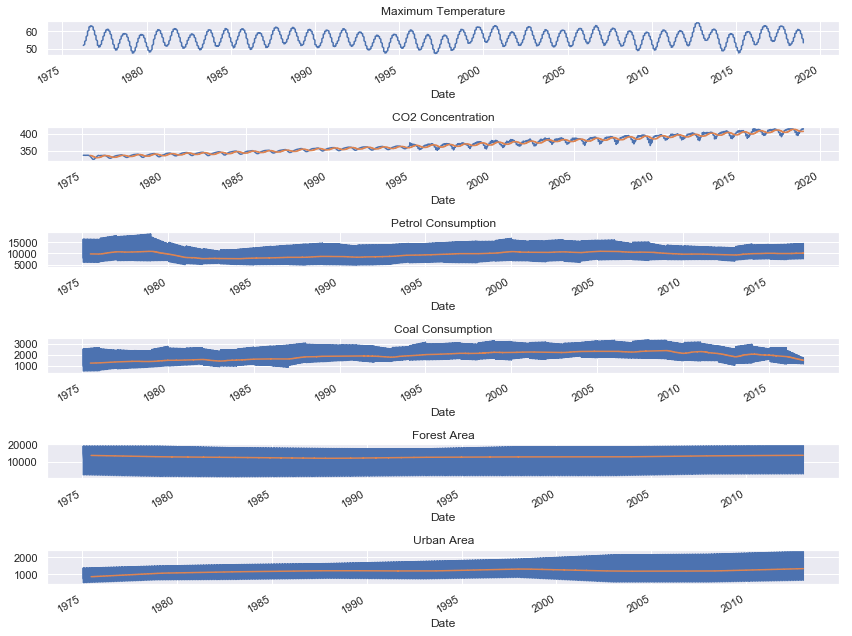

In [501]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area shows a decrease in temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds shows a decrease in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

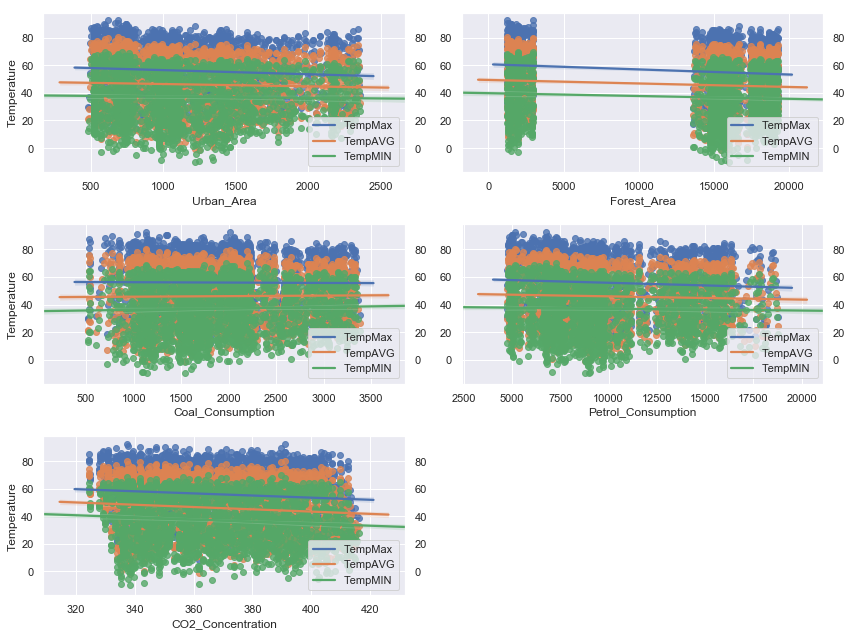

In [502]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

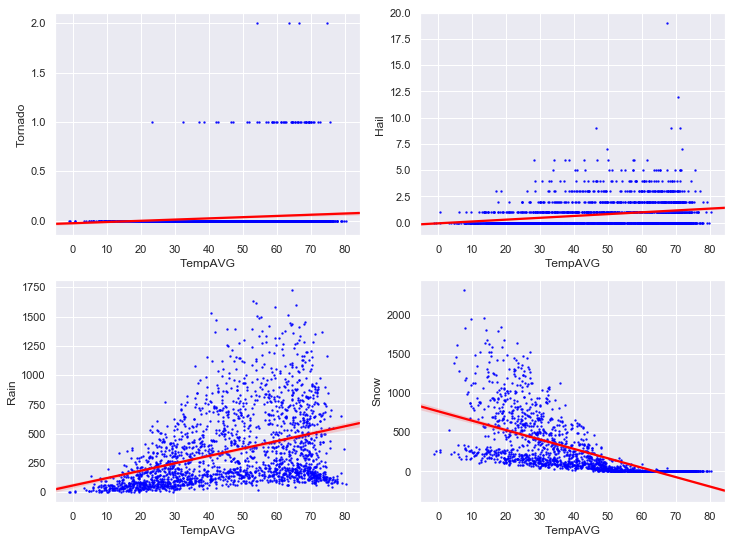

In [503]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

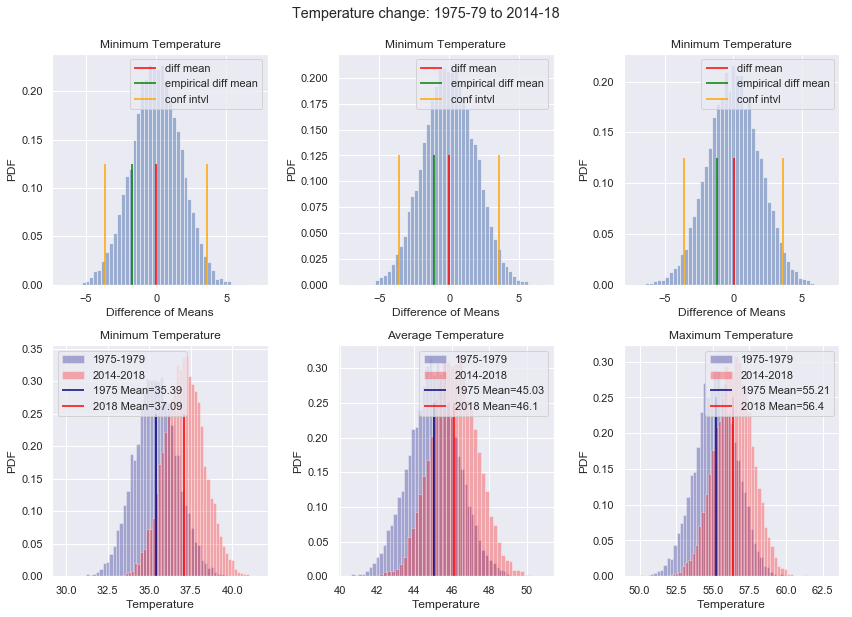

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.1621
Compare Means p-value = 0.0924
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.2863
Compare Means p-value = 0.2093
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.2567
Compare Means p-value = 0.1998
    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018


In [504]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for East North Central
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## Northeast

In [505]:
Current_Region = 'Northeast'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Northeast region since 1975.

The chart shows fluctuations in the trend in Northeast region temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [506]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

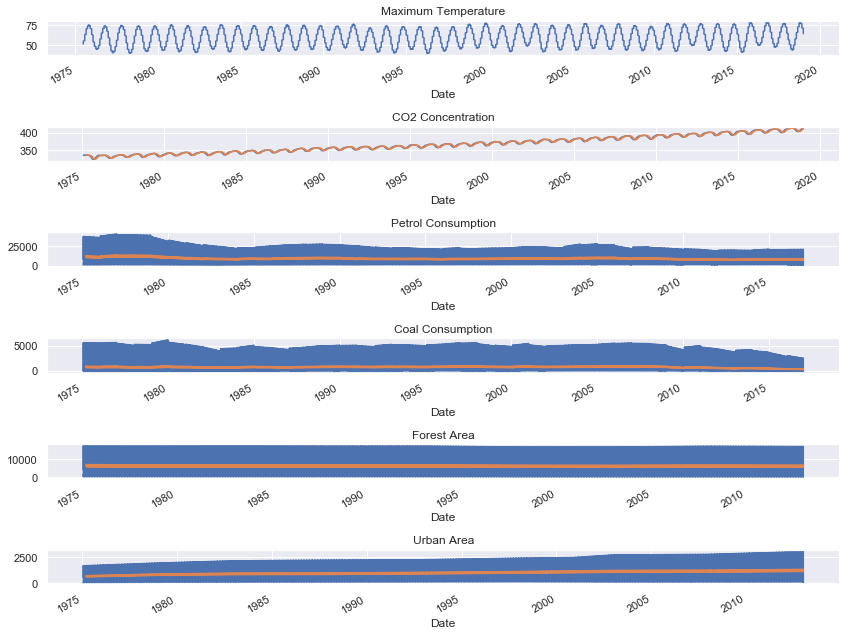

In [507]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

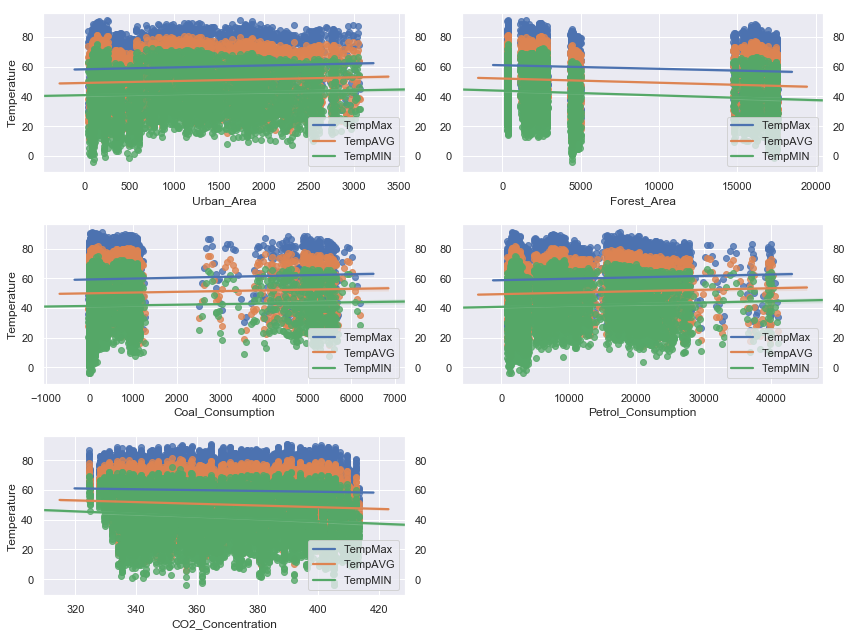

In [508]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

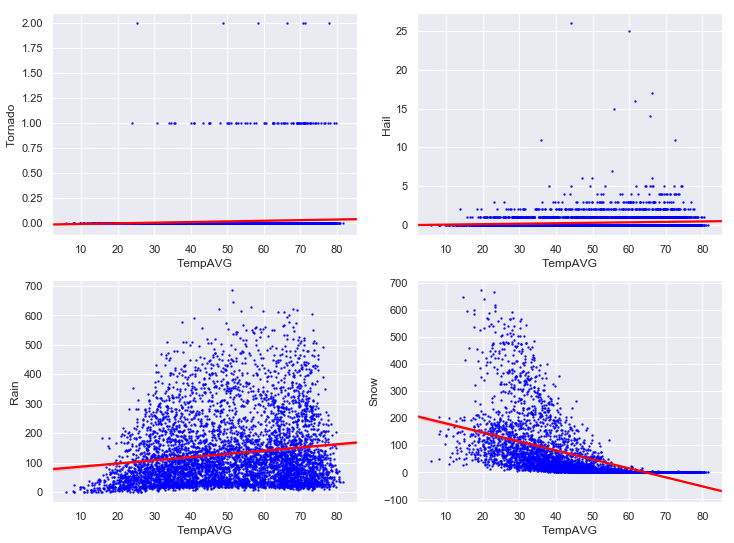

In [509]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

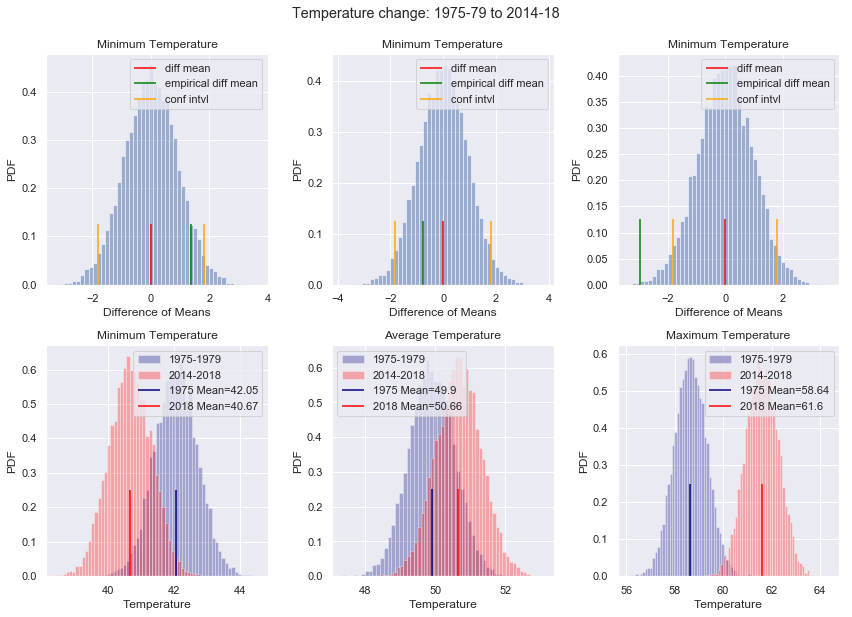

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.0665
Compare Means p-value = 0.0172
    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.

On average, 5 year mean MIN temperature in Northeast between 1975-79 and 2014-18 changed around 2.49F

Average Temperature:
Shifted Means p-value = 0.2024
Compare Means p-value = 0.1221
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.0009
Compare Means p-value = 0.0
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in Northeast bet

In [510]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Northeast
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## West

In [511]:
Current_Region = 'West'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Wisconsin since 1975.

The chart shows fluctuations in the trend in Wisconsin temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [512]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

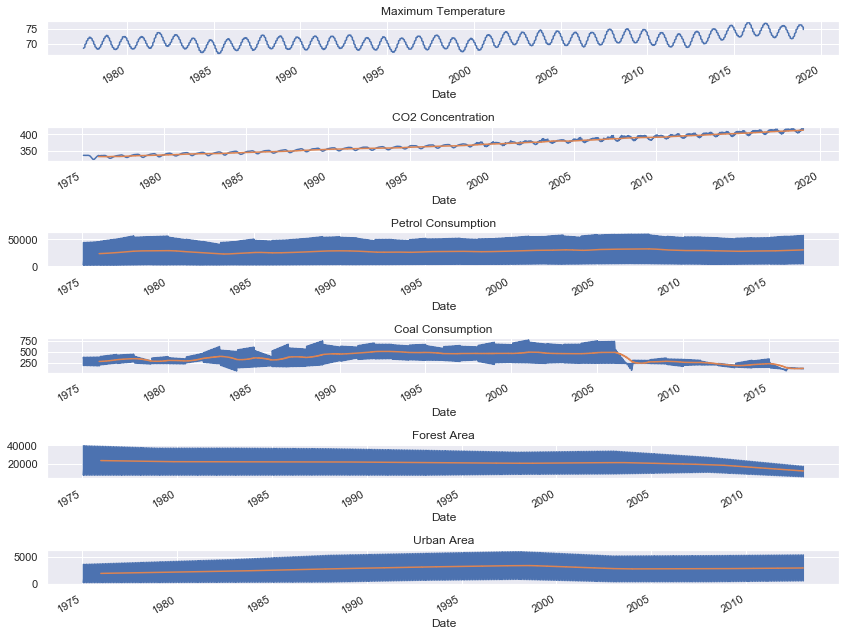

In [513]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

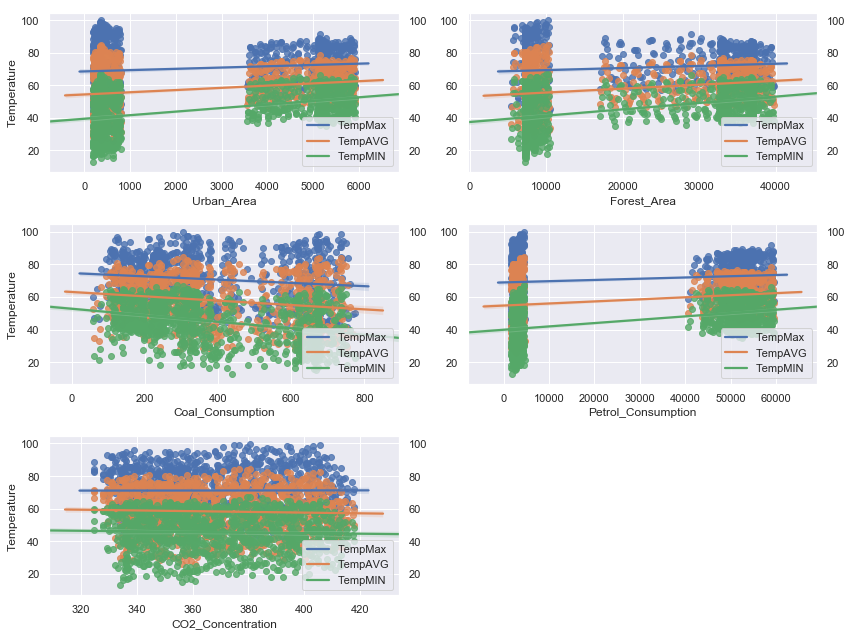

In [514]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

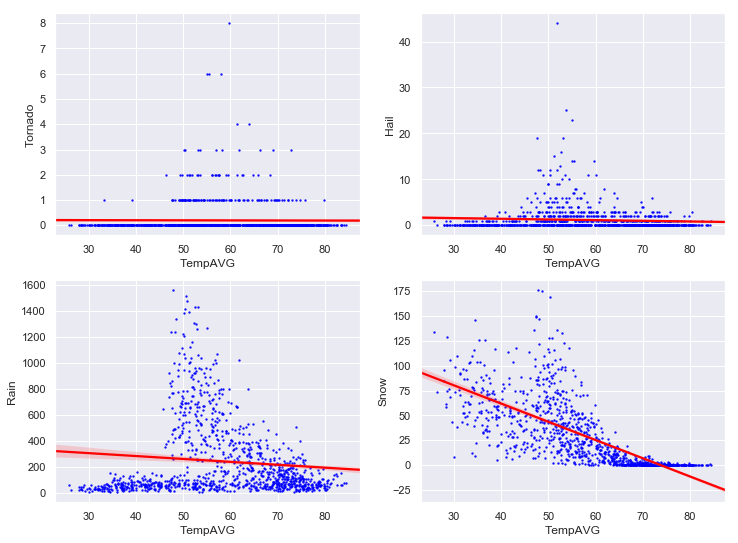

In [515]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

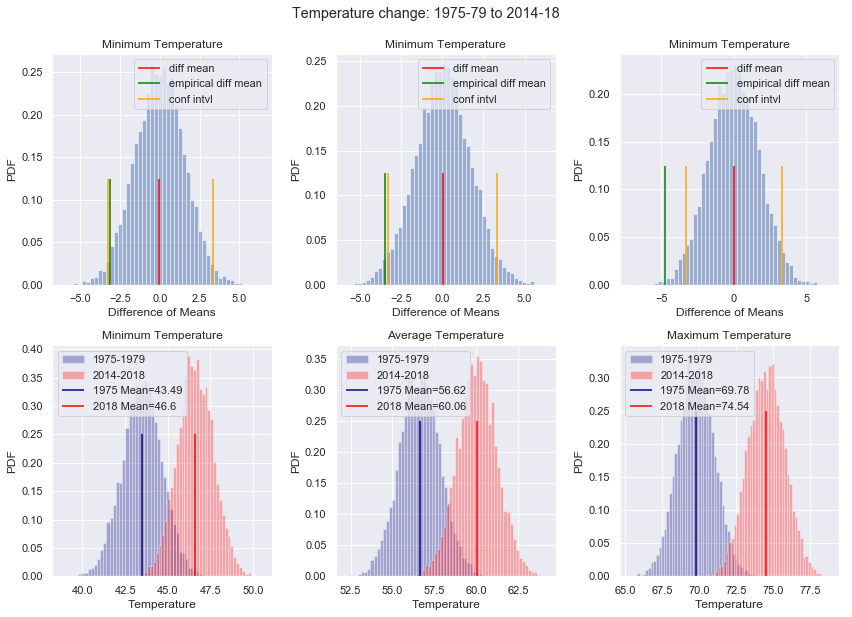

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.0221
Compare Means p-value = 0.0037
    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.

On average, 5 year mean MIN temperature in West between 1975-79 and 2014-18 changed around 2.49F

Average Temperature:
Shifted Means p-value = 0.0192
Compare Means p-value = 0.0022
    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.

On average, 5 year mean temperature in West between 1975-79 and 2014-18 changed around 3.32F

Maximum Temperature:
Shifted Means p-value = 0.003
Compare Means p-value = 0.0001
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different

In [516]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for West
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## Southwest

In [517]:
Current_Region = 'Southwest'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Wisconsin since 1975.

The chart shows fluctuations in the trend in Wisconsin temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [518]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

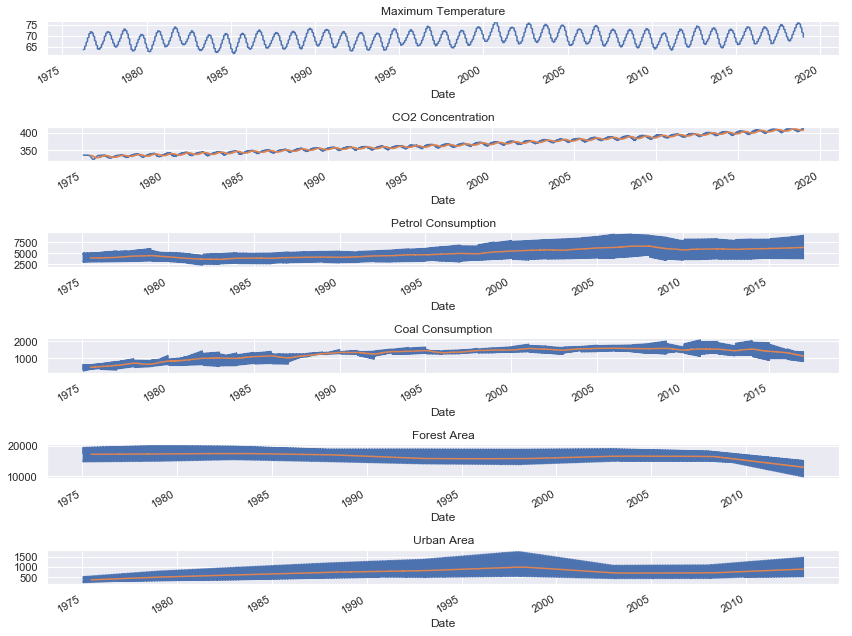

In [519]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

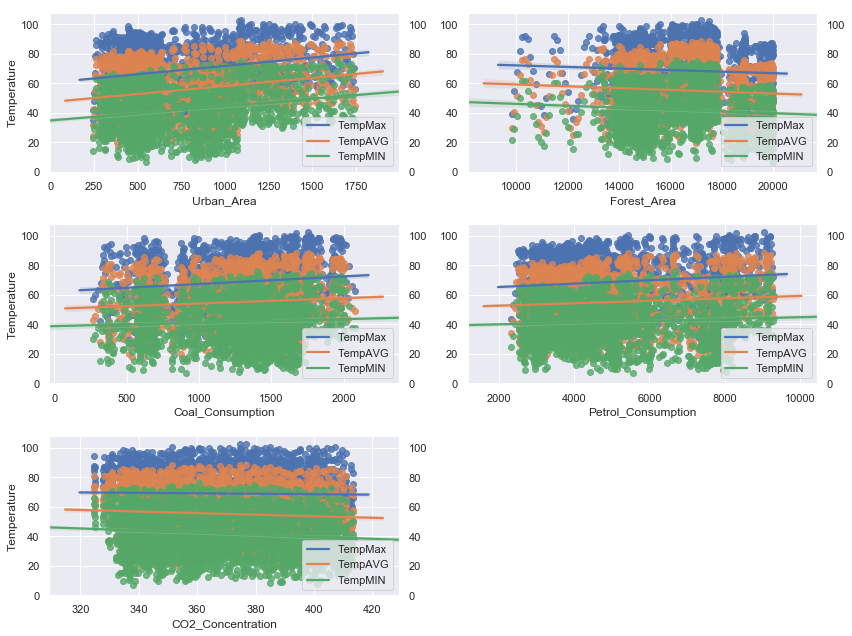

In [520]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

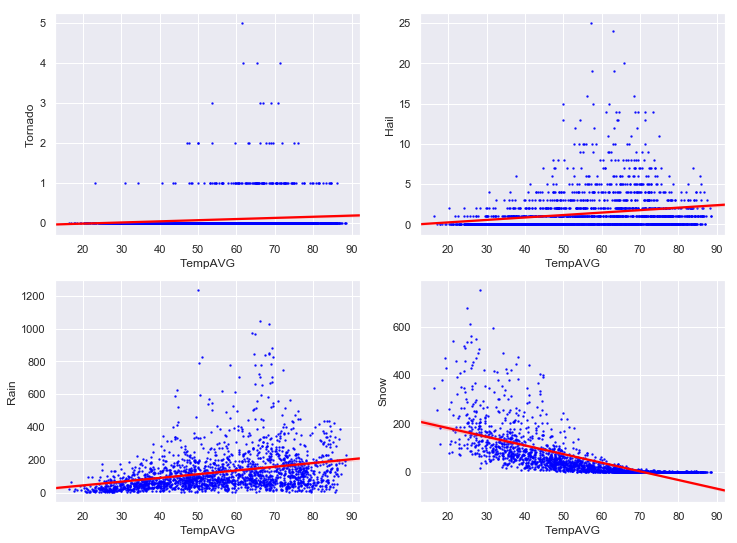

In [521]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

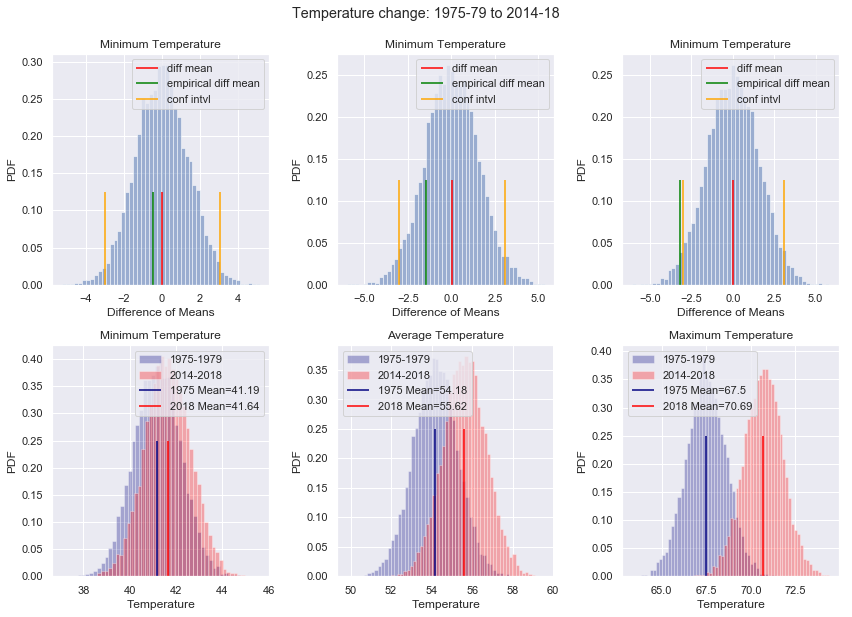

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.3772
Compare Means p-value = 0.3274
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.1624
Compare Means p-value = 0.0939
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.0218
Compare Means p-value = 0.002
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in Southwest between 1975-79 and 2014-18 changed around 4.17F


In [522]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Southwest
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## Central

In [523]:
Current_Region = 'Central'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Wisconsin since 1975.

The chart shows fluctuations in the trend in Wisconsin temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [524]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

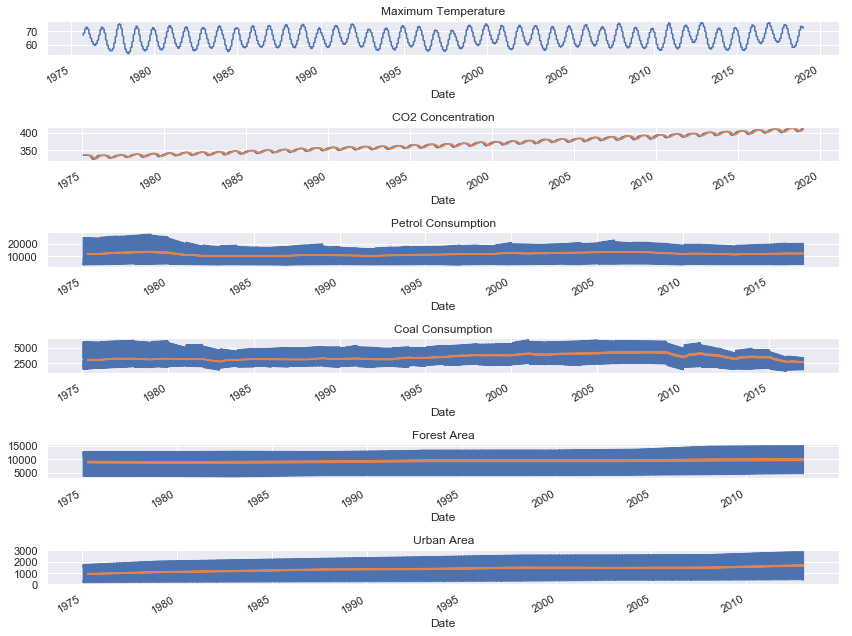

In [525]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

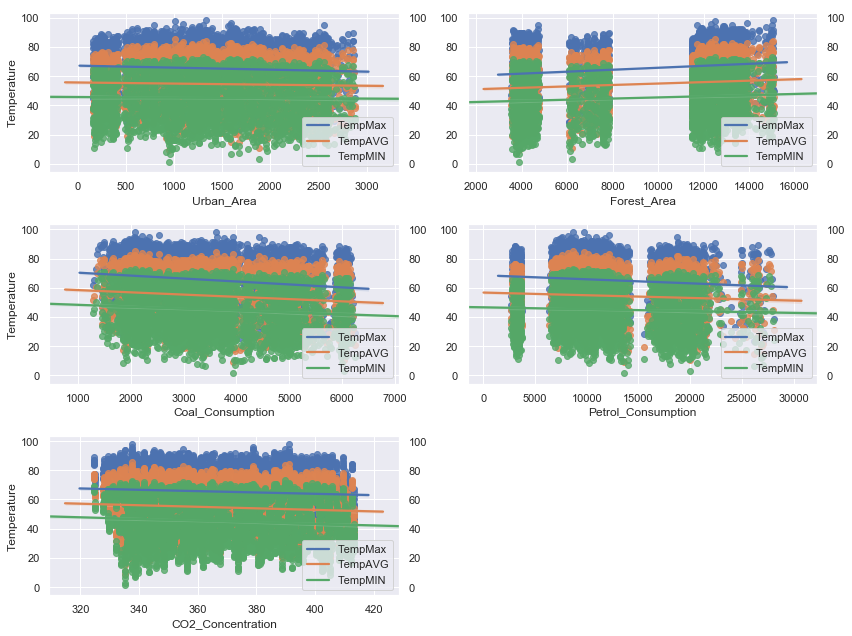

In [526]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

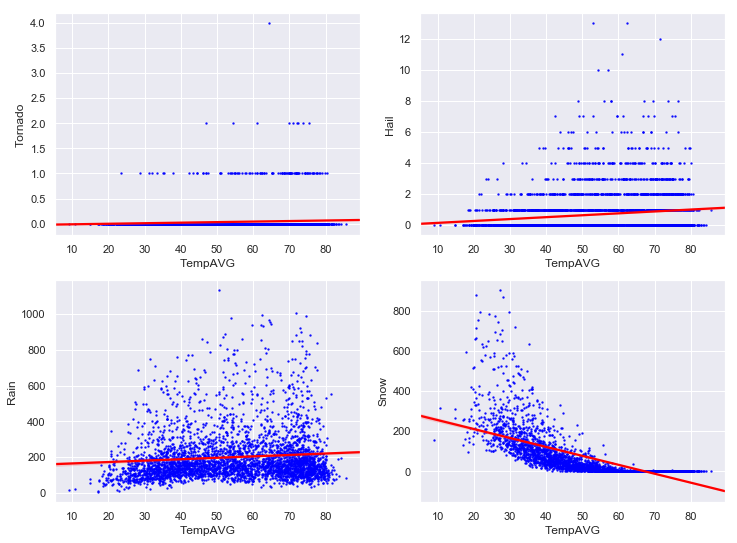

In [527]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

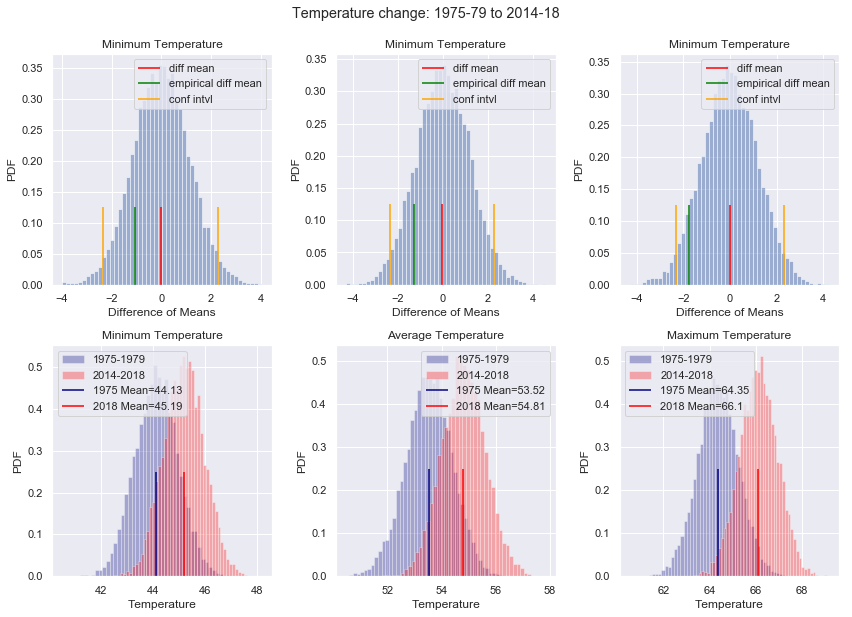

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.1756
Compare Means p-value = 0.1013
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.1442
Compare Means p-value = 0.0674
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.073
Compare Means p-value = 0.0245
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in Central between 1975-79 and 2014-18 changed around 4.17F


In [528]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Central
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## South

In [529]:
Current_Region = 'South'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Wisconsin since 1975.

The chart shows fluctuations in the trend in Wisconsin temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [530]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

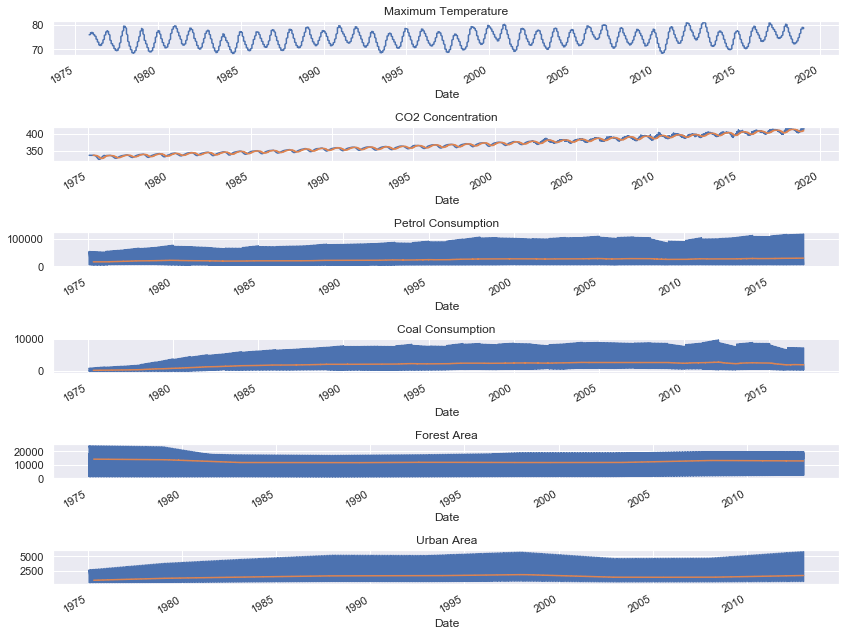

In [531]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

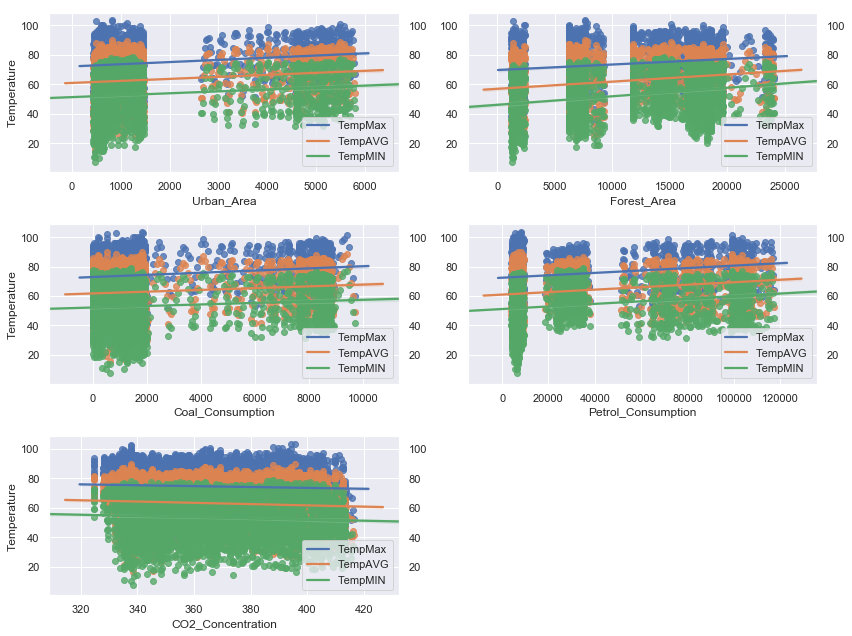

In [532]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

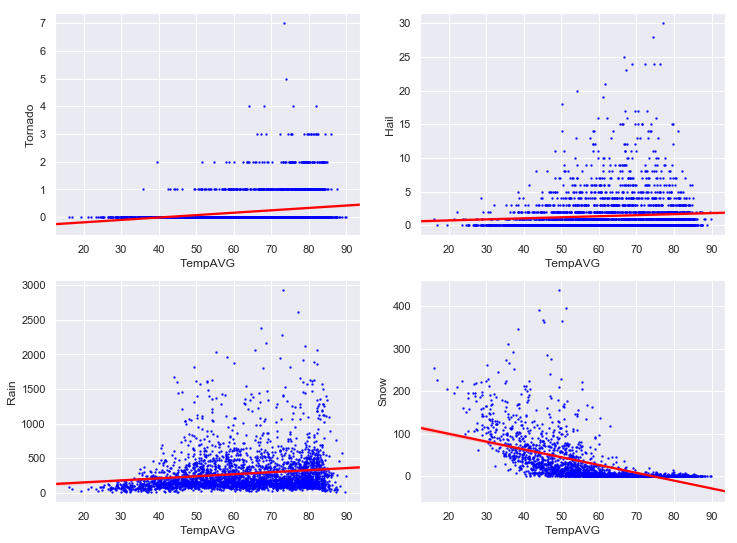

In [533]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

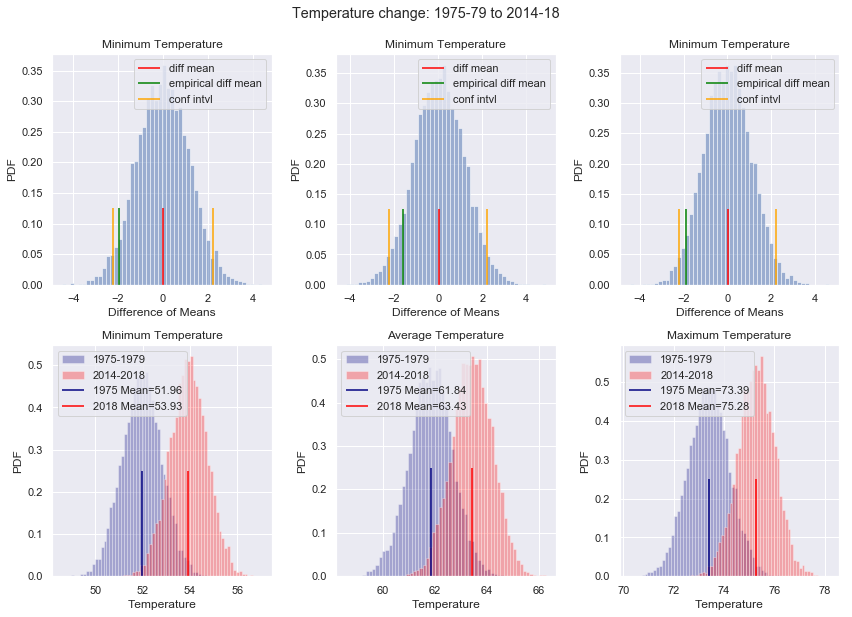

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.0453
Compare Means p-value = 0.0094
    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.

On average, 5 year mean MIN temperature in South between 1975-79 and 2014-18 changed around 2.49F

Average Temperature:
Shifted Means p-value = 0.0796
Compare Means p-value = 0.0274
    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.

On average, 5 year mean temperature in South between 1975-79 and 2014-18 changed around 3.32F

Maximum Temperature:
Shifted Means p-value = 0.035
Compare Means p-value = 0.0104
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is differe

In [534]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for South
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## Southeast

In [535]:
Current_Region = 'Southeast'

#Extract all data for Northwest
Climate_Data_Region = Climate_Data.loc[Climate_Data['Region']==Current_Region,:]
Climate_Data_Region = Climate_Data_Region.reset_index().set_index('Date')

#### Temperature Trend

The chart below shows temperature trend for Wisconsin since 1975.

The chart shows fluctuations in the trend in Wisconsin temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures increased slightly by around 1&#8457;

&#9757;

In [536]:
traceTempMaxRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_Region.index, y=Climate_Data_Region.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_Region,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

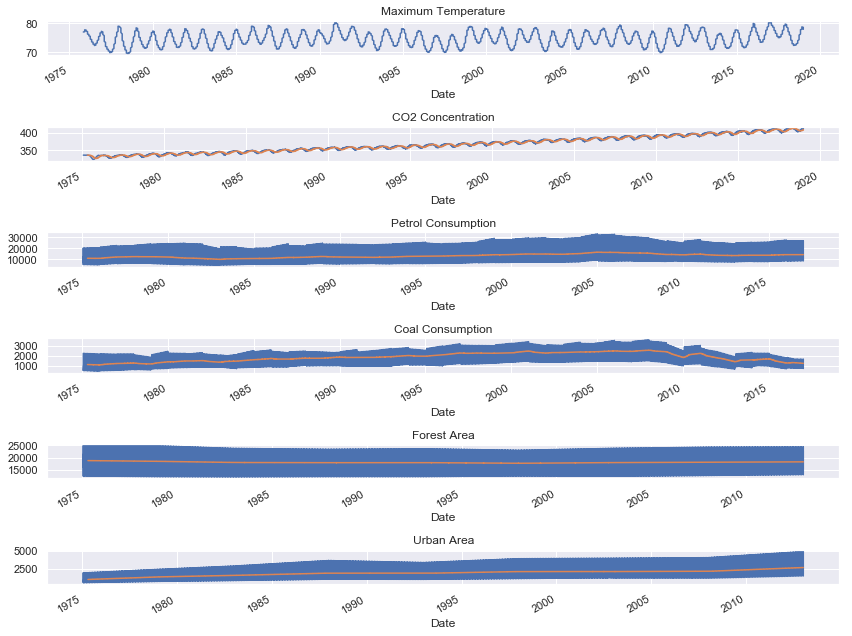

In [537]:
plt.subplot(6,1,1)
Climate_Data_Region.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_Region.CO2_Concentration.plot()
Climate_Data_Region.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_Region.Petrol_Consumption.plot()
Climate_Data_Region.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_Region.Coal_Consumption.plot()
Climate_Data_Region.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_Region.Forest_Area.plot()
Climate_Data_Region.Forest_Area.rolling(24).mean().plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_Region.Urban_Area.plot()
Climate_Data_Region.Urban_Area.rolling(24).mean().plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

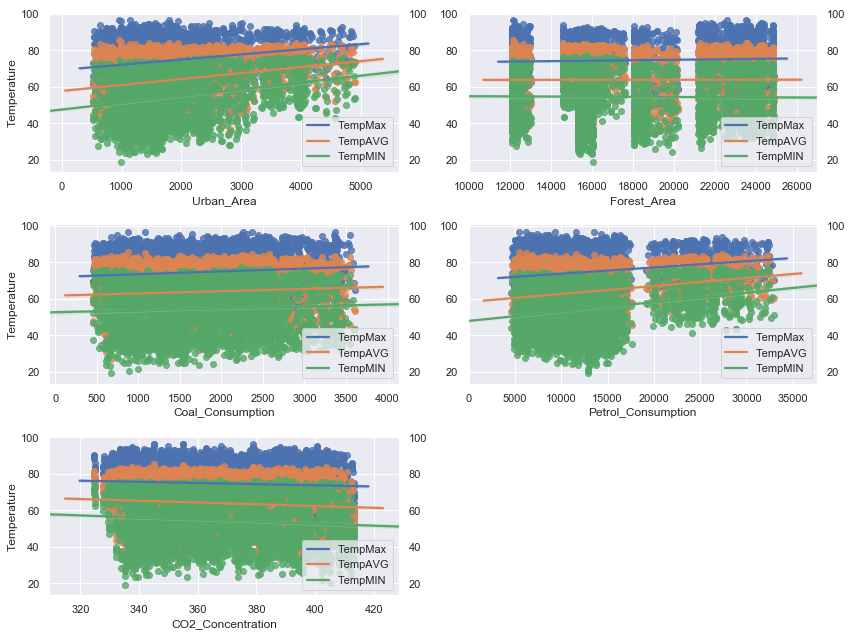

In [538]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_Region,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

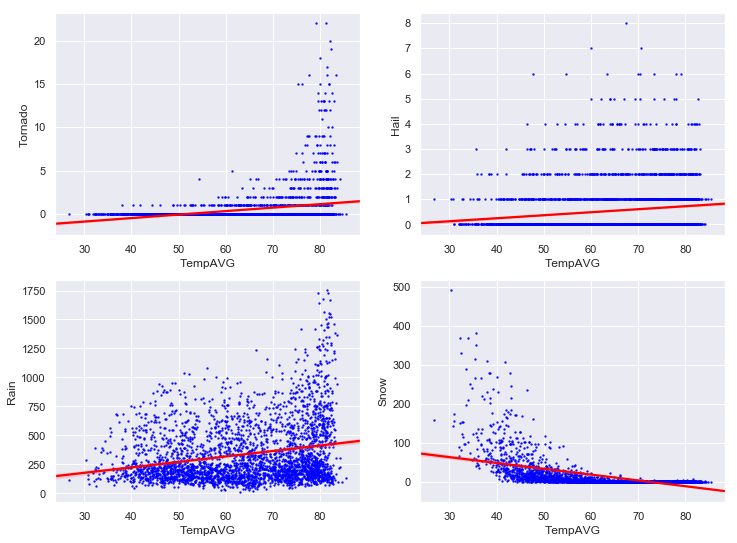

In [539]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_Region,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_Region,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_Region,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_Region,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

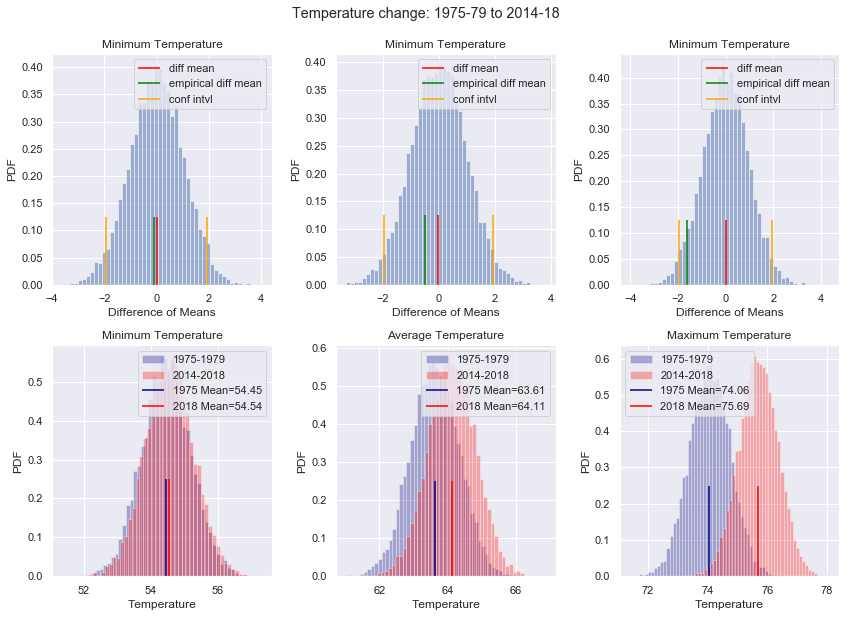

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.4577
Compare Means p-value = 0.4465
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.3123
Compare Means p-value = 0.2407
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.0534
Compare Means p-value = 0.0092
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in Southeast between 1975-79 and 2014-18 changed around 4.17F


In [540]:
#Shifted means method

Climate_Data_Region_1975, Climate_Data_Region_2018 = extract_subdata_yearly(Climate_Data_Region)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMIN'],Climate_Data_Region_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempAVG'],Climate_Data_Region_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_Region_1975['TempMAX'],Climate_Data_Region_2018['TempMAX'])

bs_TempMin_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_region_2018)-np.mean(bs_TempMin_data_region_1975))/np.std(bs_TempMin_data_region_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_region_2018)-np.mean(bs_TempAVG_data_region_1975))/np.std(bs_TempAVG_data_region_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_region_2018 = draw_bs_samples(Climate_Data_Region_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_region_1975 = draw_bs_samples(Climate_Data_Region_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_region_2018)-np.mean(bs_TempMax_data_region_1975))/np.std(bs_TempMax_data_region_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='red',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='green',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_region_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_region_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_region_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_region_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_region_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_region_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_Region +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Southeast
The visual data analysis and statistical data analysis of temperatures in Wisconsin from 1975 show that the climate change doesn't have any effect on the temperature trend in Wisconsin. 

## Hawaii (HI)

In [541]:
Current_State = 'HI'

In [542]:
#Extract all data for HI
Climate_Data_State = Climate_Data.loc[Climate_Data.index.get_level_values('State')==Current_State,:]
Climate_Data_State = Climate_Data_State.reset_index().set_index('Date')

In [543]:
Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.min():Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.max()] = Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.min():Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.max()].interpolate() 

#### Temperature Trend

The chart below shows temperature trend for Hawaii since 1975.

The chart shows fluctuations in the trend in Hawaii temperatures. Closely examining the trend lines shows that the Max, Avg, and Min temperatures fluctuated over the years with varying trend.

&#9757;

In [544]:
traceTempMaxRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_State,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years.

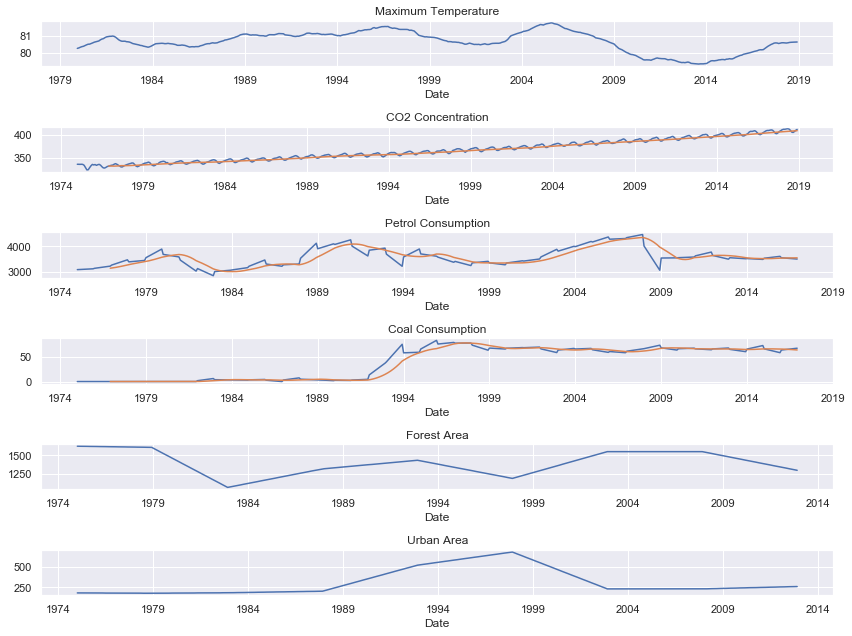

In [545]:
plt.subplot(6,1,1)
Climate_Data_State.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_State.CO2_Concentration.plot()
Climate_Data_State.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_State.Petrol_Consumption.plot()
Climate_Data_State.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_State.Coal_Consumption.plot()
Climate_Data_State.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_State.Forest_Area.plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_State.Urban_Area.plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

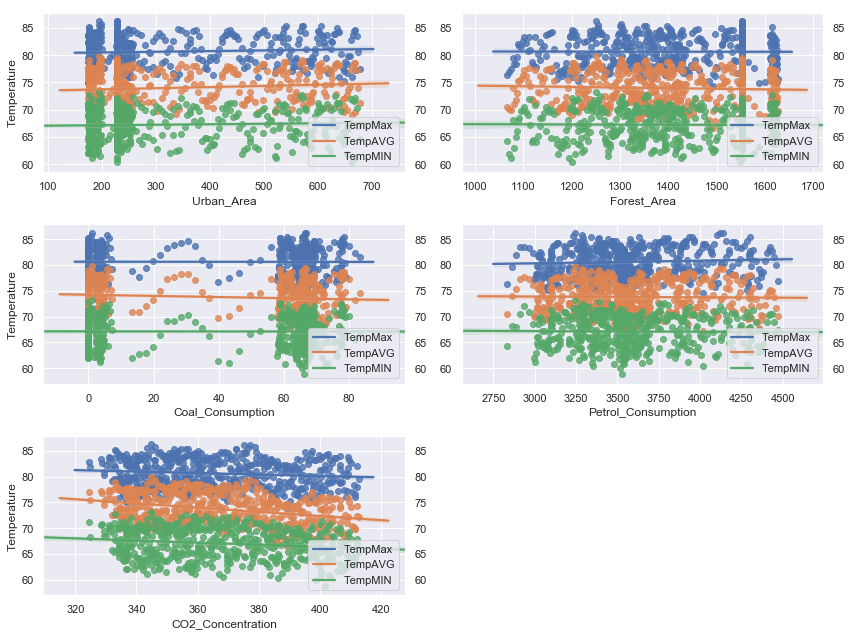

In [546]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** In case of Hawaii, raise in temperature seem to decrease torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Same goes with the rain, raise in temperature seem to decrease rainfall.<br>
**Snow:** On contrary, eaise in temperature corresponds to increase in snow days in Hawaii.

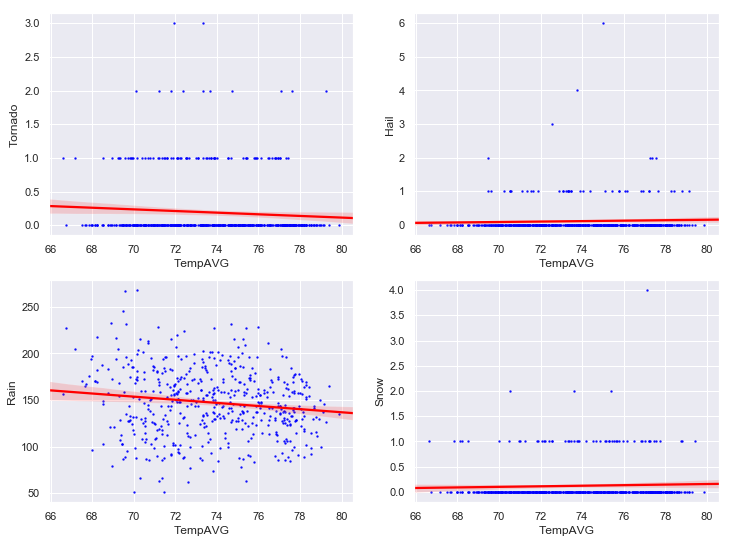

In [547]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_State,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_State,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_State,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_State,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

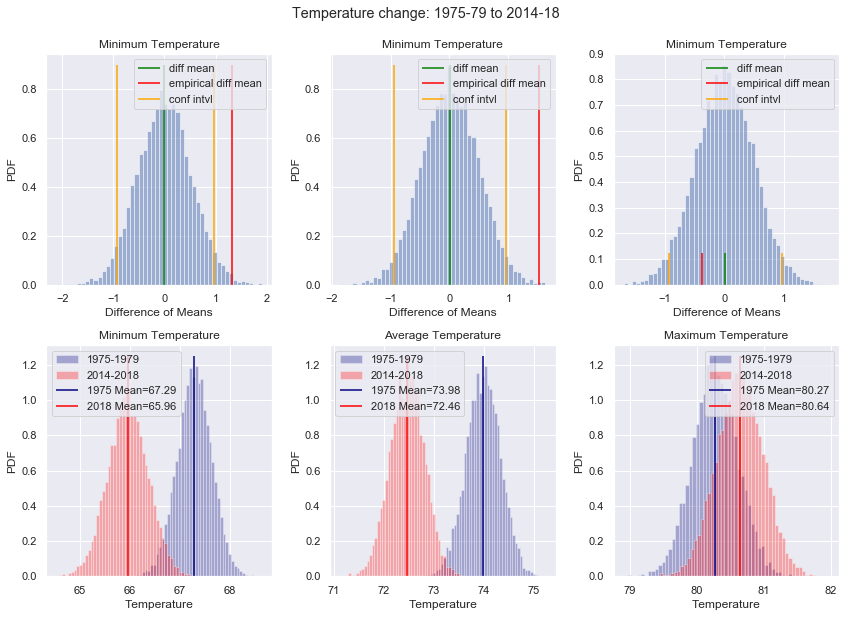

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.0058
Compare Means p-value = 0.0001
    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.

On average, 5 year mean MIN temperature in HI between 1975-79 and 2014-18 changed around -1.33F

Average Temperature:
Shifted Means p-value = 0.0012
Compare Means p-value = 0.0
    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.

On average, 5 year mean temperature in HI between 1975-79 and 2014-18 changed around -1.52F

Maximum Temperature:
Shifted Means p-value = 0.2181
Compare Means p-value = 0.1365
    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature i

In [548]:
#Shifted means method

Climate_Data_State_1975, Climate_Data_State_2018 = extract_subdata_yearly(Climate_Data_State)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempMIN'],Climate_Data_State_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempAVG'],Climate_Data_State_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempMAX'],Climate_Data_State_2018['TempMAX'])

bs_TempMin_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975))/np.std(bs_TempMin_data_state_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975))/np.std(bs_TempAVG_data_state_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975))/np.std(bs_TempMax_data_state_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.9,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.9,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.9,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.9,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.9,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.9,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_state_1975),ymin=0,ymax=1.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_state_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_state_2018),ymin=0,ymax=1.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_state_1975),ymin=0,ymax=1.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_state_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_state_2018),ymin=0,ymax=1.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_state_1975),ymin=0,ymax=1.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_state_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_state_2018),ymin=0,ymax=1.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Hawaii
The visual data analysis and statistical data analysis of temperatures in Hawaii from 1975 show that the climate change has an impact on the temperatures in Hawaii - However, the statistical analysis show that min and mean temperatures decreased in 2018.

Even the decrease in temperatures is considered an anamoly of climate change. 

The maximum temperature trend increased but not to a 95% significant level that null hypothesis can be ruled out.

## Alaska (AK)

In [549]:
Current_State = 'AK'

In [550]:
#Extract all data for AK
Climate_Data_State = Climate_Data.loc[Climate_Data.index.get_level_values('State')==Current_State,:]
Climate_Data_State = Climate_Data_State.reset_index().set_index('Date')

In [551]:
Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.min():Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.max()] = Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.min():Climate_Data_State.CO2_Concentration[Climate_Data_State.CO2_Concentration.notna()].index.max()].interpolate() 

### Insight
I chose to present Alaska because the recent trends in the ice capped state are alarming and present significant danger to the ecosystems within the state and also around the world due to its potential to raise sealevel.

#### Temperature Trend

The chart below shows temperature trend for Alaska since 1975.

The chart shows fluctuations in the trend in Alaska temperatures. Temperature in Alaska has been on a dangerous upward trend due to many factors - mostly human - over the past years.

&#9757;

In [552]:
traceTempMaxRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMAX.rolling(48).mean(),name='Max Temperature trend',line=dict(color='red'))
traceTempAvgRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempAVG.rolling(48).mean(),name='Avg Temperature trend',line=dict(color='peru'))
traceTempMinRoll = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMIN.rolling(48).mean(),name='Min Temperature trend',line=dict(color='blueviolet'))
traceTempMax = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMAX,name='Max Temperature',line=dict(color='red'),opacity=0.4)
traceTempAvg = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempAVG,name='Avg Temperature',line=dict(color='peru'),opacity=0.4)
traceTempMin = go.Line(x=Climate_Data_State.index, y=Climate_Data_State.TempMIN,name='Min Temperature',line=dict(color='blueviolet'),opacity=0.4)
layoutTempDate = go.Layout(title='Temperature over Time - ' + Current_State,showlegend=True)
figTempDate = go.Figure(data=[traceTempMaxRoll,traceTempAvgRoll,traceTempMinRoll,traceTempMax,traceTempAvg,traceTempMin],layout=layoutTempDate)
iplot(figTempDate)

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years with an upward trend, and dangerously so in the recent years.

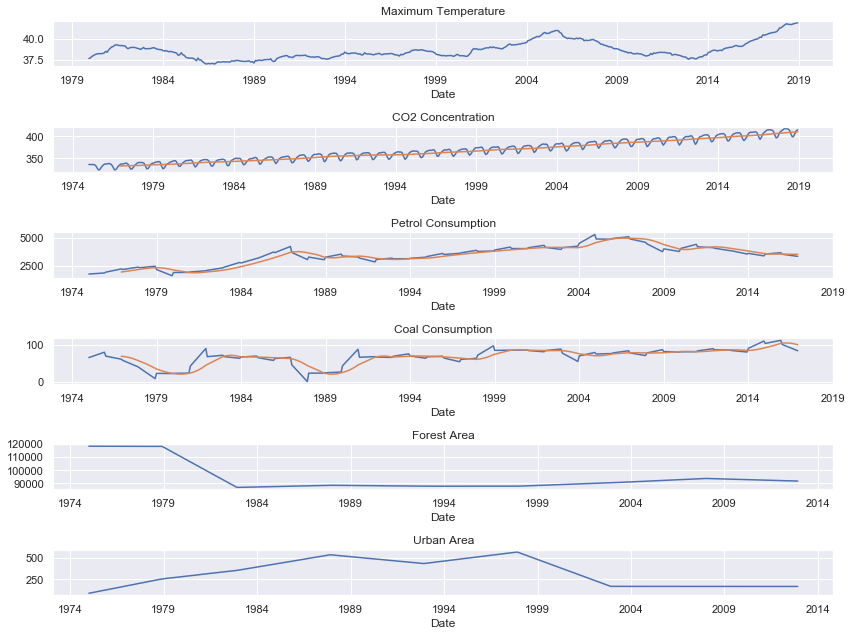

In [553]:
plt.subplot(6,1,1)
Climate_Data_State.TempMAX.rolling(60).mean().plot()
plt.title('Maximum Temperature')
plt.subplot(6,1,2)
Climate_Data_State.CO2_Concentration.plot()
Climate_Data_State.CO2_Concentration.rolling(24).mean().plot()
plt.title('CO2 Concentration')
plt.subplot(6,1,3)
Climate_Data_State.Petrol_Consumption.plot()
Climate_Data_State.Petrol_Consumption.rolling(24).mean().plot()
plt.title('Petrol Consumption')
plt.subplot(6,1,4)
Climate_Data_State.Coal_Consumption.plot()
Climate_Data_State.Coal_Consumption.rolling(24).mean().plot()
plt.title('Coal Consumption')
plt.subplot(6,1,5)
Climate_Data_State.Forest_Area.plot()
plt.title('Forest Area')
plt.subplot(6,1,6)
Climate_Data_State.Urban_Area.plot()
plt.title('Urban Area')
plt.tight_layout()

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area doesn't seem to have an effect on temperatures<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

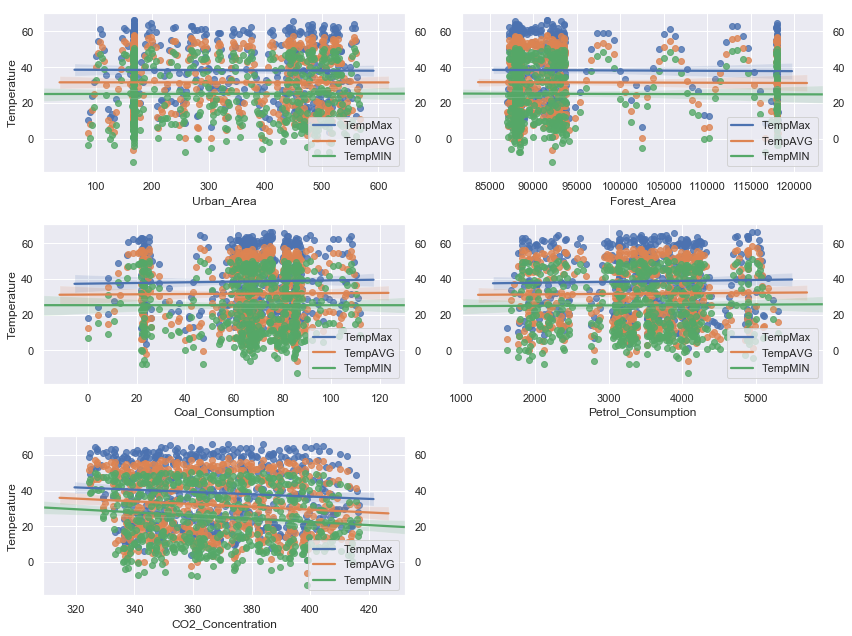

In [554]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data_State,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse affects on Earth's natural pheonomena. The chart below shows the effect of temperature changes in natural event occurances.<br>
**Tornado:** Raise in temperature corresponds to increase in torando occurances.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurances.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

The melting ice and increase in rainfall in Alaska as temperatures raise pose a threat to many coastal cities around the world in the next decades.

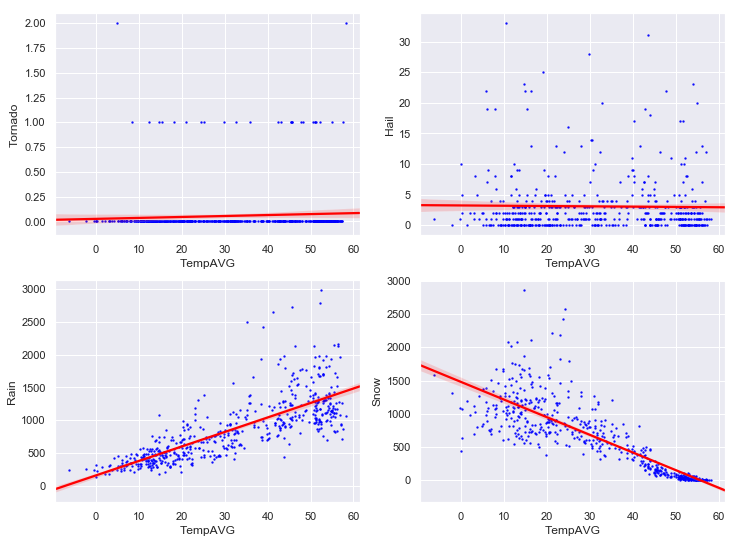

In [555]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data_State,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data_State,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data_State,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data_State,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

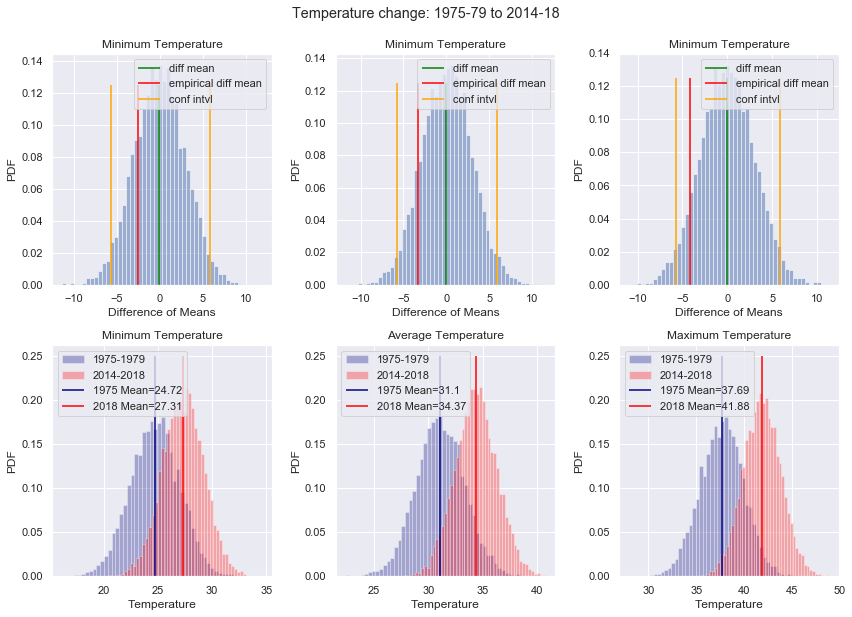

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.1992
Compare Means p-value = 0.1244
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.1305
Compare Means p-value = 0.0715
    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018

Maximum Temperature:
Shifted Means p-value = 0.0799
Compare Means p-value = 0.0331
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in AK between 1975-79 and 2014-18 changed around 4.19F


In [556]:
#Shifted means method

Climate_Data_State_1975, Climate_Data_State_2018 = extract_subdata_yearly(Climate_Data_State)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempMIN'],Climate_Data_State_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempAVG'],Climate_Data_State_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_State_1975['TempMAX'],Climate_Data_State_2018['TempMAX'])

bs_TempMin_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975))/np.std(bs_TempMin_data_state_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975))/np.std(bs_TempAVG_data_state_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_state_2018 = draw_bs_samples(Climate_Data_State_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_state_1975 = draw_bs_samples(Climate_Data_State_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975))/np.std(bs_TempMax_data_state_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,0.125,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,0.125,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,0.125,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,0.125,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,0.125,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,0.125,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,0.125,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_state_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_state_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_state_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_state_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_state_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_state_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_state_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_state_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_state_1975),ymin=0,ymax=0.25,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_state_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_state_2018),ymin=0,ymax=0.25,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_state_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_state_2018)-np.mean(bs_TempMin_data_state_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_state_2018)-np.mean(bs_TempAVG_data_state_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in '+ Current_State +' between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_state_2018)-np.mean(bs_TempMax_data_state_1975),2)) + 'F')


#### Conclusion for Alaska
The visual data analysis and statistical data analysis of temperatures in Alaska from 1975 show that the climate change has an impact in temperatures in Alaska.<br>
Although min and mean temperature changes cannot be confidently rejected, max temperature levels significantly increased - by 4.1&#8457;<br>
The statistical analysis also shows that min and mean temperatures increased, although not to a 95% confidence level. 

Temperature raise in Alaska is particularly dangerous because melting ice caps in Alaska directly contribute to the rising sea levels. Temperature raise in this state is not just dangerous for humans, but also for the wildlife that habitat in Alaska. Temperature increase is affecting the beauty of Alaska, which is tourism dependent state, leading to an economic downturn in the state.

## Overall USA

### Insight


#### Temperature Trend

The chart below developed on Tableau presents an interactive platform for you to explore the climate change by state over the recent years.

&#9757;

In [557]:
HTML('''<div class='tableauPlaceholder' id='viz1548265620435' style='position: relative'>
            <noscript>
                <a href='#'>
                    <img alt=' ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Cl&#47;ClimateChangeAnalysis&#47;TemperatureTrend_1&#47;1_rss.png' style='border: none' />
                </a>
            </noscript>
            <object class='tableauViz'  style='display:none;'>
                <param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> 
                <param name='embed_code_version' value='3' />
                <param name='site_root' value='' />
                <param name='name' value='ClimateChangeAnalysis&#47;TemperatureTrend_1' />
                <param name='tabs' value='yes' />
                <param name='toolbar' value='yes' />
                <param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Cl&#47;ClimateChangeAnalysis&#47;TemperatureTrend_1&#47;1.png' /> 
                <param name='animate_transition' value='yes' />
                <param name='display_static_image' value='yes' />
                <param name='display_spinner' value='yes' />
                <param name='display_overlay' value='yes' />
                <param name='display_count' value='yes' />
            </object>
        </div>                
        <script type='text/javascript'>
            var divElement = document.getElementById('viz1548265620435');
            var vizElement = divElement.getElementsByTagName('object')[0];
            vizElement.style.minWidth='420px';
            vizElement.style.maxWidth='1550px';
            vizElement.style.width='100%';
            vizElement.style.minHeight='610px';
            vizElement.style.maxHeight='910px';
            vizElement.style.height=(divElement.offsetWidth*0.75)+'px';
            var scriptElement = document.createElement('script');
            scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';
            vizElement.parentNode.insertBefore(scriptElement, vizElement);
        </script>''')

#### Factor Visualization

The chart below shows the trends of Maximum temparature with all the other factors - CO2 concentration, Fossil fuel consumption, and Land use.

Temperature is dependent on many factors. Examining the chart shows fluctuations in average maximum temperature and dependent factors over the years with an upward trend, and dangerously so in the recent years.

#### Temperature Factor Correlation

The regression plot below shows effect of all the factors over Max, Avg, and Min temperatures over the years.<br>
**Urban Area:** Increase in Urban Area corresponds to increase in temperatures<br>
**Forest Area:** Increase in Forest Area has a profound impact in decreasing the temperatures. Scientific reason we should plant more trees!<br>
**Coal Consumption:** Increase in consumption of coal corresponds to increase in temperatures<br>
**Petrol Consumption:** Increase in consumption of petrol corresponds to increase in temperatures<br>
**CO2 Concentration:** The chart shows that increase in atmospheric CO2 concentration correspond to decrease in temperatures, contrary to the scientific explanation. This could be due to low correlation values of CO2 data with available temperature data.

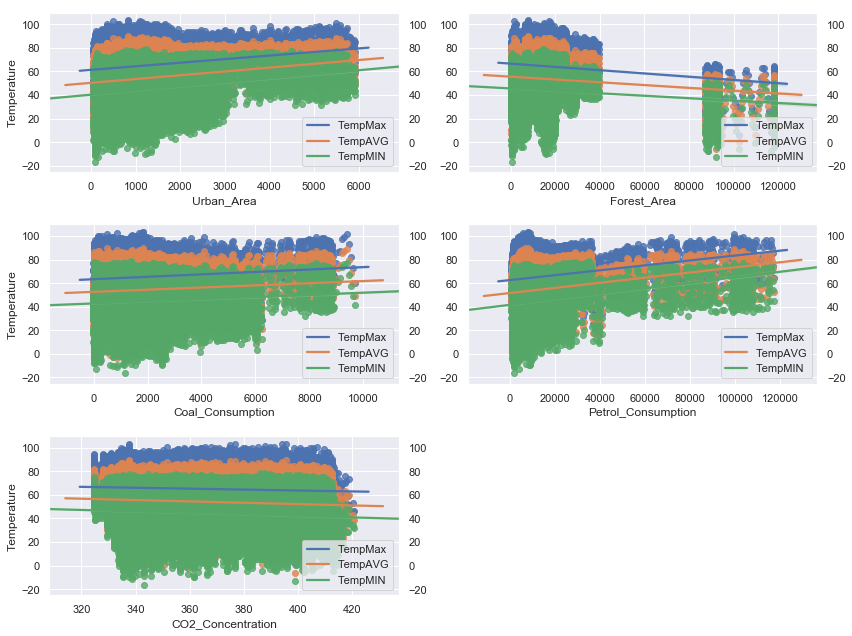

In [558]:
plt.subplot(3,2,1)
sns.regplot(data=Climate_Data,x='Urban_Area',y='TempMAX')
sns.regplot(data=Climate_Data,x='Urban_Area',y='TempAVG')
sns.regplot(data=Climate_Data,x='Urban_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,2)
sns.regplot(data=Climate_Data,x='Forest_Area',y='TempMAX')
sns.regplot(data=Climate_Data,x='Forest_Area',y='TempAVG')
sns.regplot(data=Climate_Data,x='Forest_Area',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,3)
sns.regplot(data=Climate_Data,x='Coal_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data,x='Coal_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data,x='Coal_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.subplot(3,2,4)
sns.regplot(data=Climate_Data,x='Petrol_Consumption',y='TempMAX')
sns.regplot(data=Climate_Data,x='Petrol_Consumption',y='TempAVG')
sns.regplot(data=Climate_Data,x='Petrol_Consumption',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel(None)
plt.subplot(3,2,5)
sns.regplot(data=Climate_Data,x='CO2_Concentration',y='TempMAX')
sns.regplot(data=Climate_Data,x='CO2_Concentration',y='TempAVG')
sns.regplot(data=Climate_Data,x='CO2_Concentration',y='TempMIN')
plt.tick_params(axis='y', which='both', labelleft='on', labelright='on')
plt.legend(['TempMax','TempAVG','TempMIN'],loc='lower right')
plt.ylabel('Temperature')
plt.tight_layout()
plt.show()

#### Natural Event Correlation

Raise in temperatures have adverse effects on Earth's natural phenomena. The chart below shows the effect of temperature changes in natural event occurrences.<br>
**Tornado:** Raise in temperature corresponds to increase in tornando occurrences.<br>
**Hail:** Raise in temperature corresponds to increase in hail occurrences.<br>
**Rain:** Raise in temperature corresponds to increase in rainfall.<br>
**Snow:** Raise in temperature corresponds to decrease in snowfall.

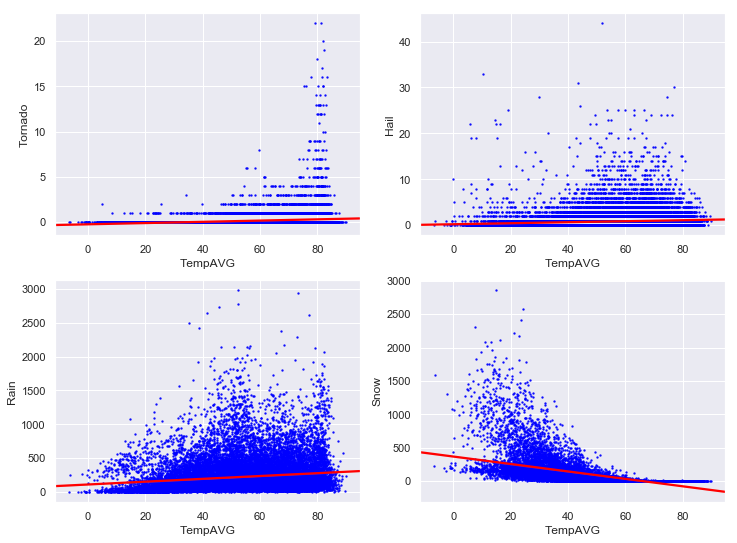

In [559]:
plt.subplot(2,2,1)
sns.regplot(data=Climate_Data,y='Tornado',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,2)
sns.regplot(data=Climate_Data,y='Hail',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,3)
sns.regplot(data=Climate_Data,y='Rain',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.subplot(2,2,4)
sns.regplot(data=Climate_Data,y='Snow',x='TempAVG',scatter_kws={'color':'blue','s':2},line_kws={'color':'red'})
plt.show()

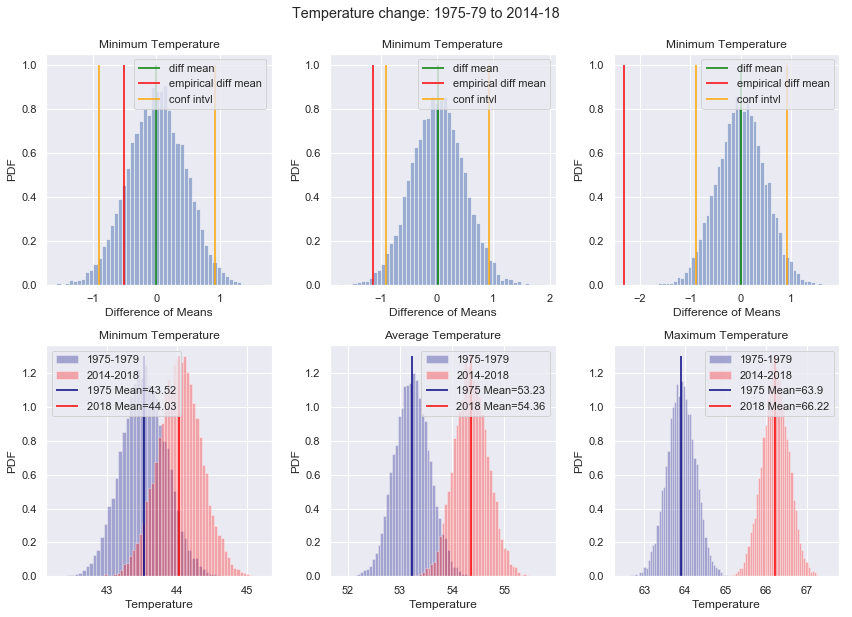

Hypothesis t-test:

Minimum Temperature:
Shifted Means p-value = 0.1283
Compare Means p-value = 0.0583
    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018

Average Temperature:
Shifted Means p-value = 0.0059
Compare Means p-value = 0.0004
    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.

On average, 5 year mean temperature in USA between 1975-79 and 2014-18 changed around 1.14F

Maximum Temperature:
Shifted Means p-value = 0.0
Compare Means p-value = 0.0
    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.

On average, 5 year mean MAX temperature in USA between 1975-79 and 20

In [560]:
#Shifted means method

Climate_Data_1975, Climate_Data_2018 = extract_subdata_yearly(Climate_Data)

CI_tempMin, ShiftMeans_p_tempMin, bs_shifted_diff_mean_tempMin, empirical_diff_mean_tempMin = bootstrap_test_sifted_mean(Climate_Data_1975['TempMIN'],Climate_Data_2018['TempMIN'])
CI_tempAvg, ShiftMeans_p_tempAvg, bs_shifted_diff_mean_tempAvg, empirical_diff_mean_tempAvg = bootstrap_test_sifted_mean(Climate_Data_1975['TempAVG'],Climate_Data_2018['TempAVG'])
CI_tempMax, ShiftMeans_p_tempMax, bs_shifted_diff_mean_tempMax, empirical_diff_mean_tempMax = bootstrap_test_sifted_mean(Climate_Data_1975['TempMAX'],Climate_Data_2018['TempMAX'])

bs_TempMin_data_2018 = draw_bs_samples(Climate_Data_2018['TempMIN'],np.mean,num_iterations)
bs_TempMin_data_1975 = draw_bs_samples(Climate_Data_1975['TempMIN'],np.mean,num_iterations)

CompMeans_z_tempMin = (np.mean(bs_TempMin_data_2018)-np.mean(bs_TempMin_data_1975))/np.std(bs_TempMin_data_1975)
CompMeans_p_tempMin = min(st.norm.cdf(CompMeans_z_tempMin),1-st.norm.cdf(CompMeans_z_tempMin))

bs_TempAVG_data_2018 = draw_bs_samples(Climate_Data_2018['TempAVG'],np.mean,num_iterations)
bs_TempAVG_data_1975 = draw_bs_samples(Climate_Data_1975['TempAVG'],np.mean,num_iterations)

CompMeans_z_tempAvg = (np.mean(bs_TempAVG_data_2018)-np.mean(bs_TempAVG_data_1975))/np.std(bs_TempAVG_data_1975)
CompMeans_p_tempAvg = min(st.norm.cdf(CompMeans_z_tempAvg),1-st.norm.cdf(CompMeans_z_tempAvg))

bs_TempMax_data_2018 = draw_bs_samples(Climate_Data_2018['TempMAX'],np.mean,num_iterations)
bs_TempMax_data_1975 = draw_bs_samples(Climate_Data_1975['TempMAX'],np.mean,num_iterations)

CompMeans_z_tempMax = (np.mean(bs_TempMax_data_2018)-np.mean(bs_TempMax_data_1975))/np.std(bs_TempMax_data_1975)
CompMeans_p_tempMax = min(st.norm.cdf(CompMeans_z_tempMax),1-st.norm.cdf(CompMeans_z_tempMax))


plt.subplot(2,3,1)
plt.hist(bs_shifted_diff_mean_tempMin,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMin),0,1,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMin,0,1,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,1,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,2)
plt.hist(bs_shifted_diff_mean_tempAvg,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempAvg),0,1,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempAvg,0,1,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,1,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,3)
plt.hist(bs_shifted_diff_mean_tempMax,bins=50,density=1,alpha=0.5)
plt.vlines(np.mean(bs_shifted_diff_mean_tempMax),0,1,color='green',label='diff mean')
plt.vlines(empirical_diff_mean_tempMax,0,1,color='red',label='empirical diff mean')
plt.vlines(CI_tempAvg,0,1,color='orange',label='conf intvl')
plt.xlabel('Difference of Means')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()


plt.subplot(2,3,4)
plt.hist(bs_TempMin_data_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMin_data_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMin_data_1975),ymin=0,ymax=1.3,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMin_data_1975),2)))
plt.vlines(np.mean(bs_TempMin_data_2018),ymin=0,ymax=1.3,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMin_data_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Minimum Temperature')
plt.legend()

plt.subplot(2,3,5)
plt.hist(bs_TempAVG_data_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempAVG_data_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempAVG_data_1975),ymin=0,ymax=1.3,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempAVG_data_1975),2)))
plt.vlines(np.mean(bs_TempAVG_data_2018),ymin=0,ymax=1.3,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempAVG_data_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Average Temperature')
plt.legend()

plt.subplot(2,3,6)
plt.hist(bs_TempMax_data_1975,bins=50,density=1,label='1975-1979',alpha=0.3, color='navy')
plt.hist(bs_TempMax_data_2018,bins=50,density=1,label='2014-2018',alpha=0.3, color='red')
plt.vlines(np.mean(bs_TempMax_data_1975),ymin=0,ymax=1.3,color='navy',label='1975 Mean='+str(np.round(np.mean(bs_TempMax_data_1975),2)))
plt.vlines(np.mean(bs_TempMax_data_2018),ymin=0,ymax=1.3,color='red',label='2018 Mean='+str(np.round(np.mean(bs_TempMax_data_2018),2)))
plt.xlabel('Temperature')
plt.ylabel('PDF')
plt.title('Maximum Temperature')
plt.legend()

plt.suptitle('Temperature change: 1975-79 to 2014-18')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print('Hypothesis t-test:')
print('\nMinimum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMin,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMin,4)))
if (ShiftMeans_p_tempMin > alpha and CompMeans_p_tempMin > alpha):
    print('    Fail to reject H0: The minimum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean minimum temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The minimum temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean minimum temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MIN temperature in USA between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMin_data_2018)-np.mean(bs_TempMin_data_1975),2)) + 'F')

print('\nAverage Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempAvg,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempAvg,4)))
if (ShiftMeans_p_tempAvg > alpha and CompMeans_p_tempAvg > alpha):
    print('    Fail to reject H0: The average temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The average temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean temperature in USA between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempAVG_data_2018)-np.mean(bs_TempAVG_data_1975),2)) + 'F')

print('\nMaximum Temperature:')
print('Shifted Means p-value = ' + str(np.round(ShiftMeans_p_tempMax,4)))
print('Compare Means p-value = ' + str(np.round(CompMeans_p_tempMax,4)))
if (ShiftMeans_p_tempMax > alpha and CompMeans_p_tempMax > alpha):
    print('    Fail to reject H0: The maximum temperature data between 1975-79 and 2014-18 is NOT STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests mean max temperature is not different between 1975 and 2018')
else:
    print('    Reject H0: The temperature data between 1975-79 and 2014-18 IS STATISTICALLY SIGNIFICANTLY DIFFERENT; Data suggests that mean max temperature is different between 1975 and 2018.')
    print('\nOn average, 5 year mean MAX temperature in USA between 1975-79 and 2014-18 changed around ' + str(np.round(np.mean(bs_TempMax_data_2018)-np.mean(bs_TempMax_data_1975),2)) + 'F')


#### Conclusion for Overall USA
The visual data analysis and statistical data analysis of temperatures in USA from 1975 show that the climate change has an impact in temperatures.<br>
Although min temperature changes cannot be confidently rejected, mean and max temperature levels significantly increased - by 1.1&#8457; and 2.2&#8457; respectively.<br>
The statistical analysis also shows that min temperatures increased, although not to a 95% confidence level. 

# Conclusion

Through the visual and statistical exploration of data, we can conclude that human activity present as factors for climate change. Data from all the states show a strong correlation between raise in temperature and the amount of fossil fuels we burn, trees we cut down, and cities we expand. <br>

The statistical analysis shows that the climate change has a profound impact on the extreme states in the heat spectrum - Temperatures significantly rose in colder states like Alaska and hotter states like Florida, and Texas. While the temperature change is not statistically significant is the medium temperature states, it prevails. 

Temperature change is a long term phenomenon. The analysis of last 40 years shows United States had a significant impact due to climate change. It will only be worse in the coming decades if no preventive action is taken. 

One interesting insight is that strangely, increase in CO2 concentration seem to inversely affect the temperature. All the charts show that increase in CO2 concentration seem to decrease temperatures. Further investigation with statistical evidence is required to dive into this insight and present a valid conclusion. <br>

Conclusively, an immediate action is absolutely necessary to counter climate change or life's future on Earth will be grim.